In [1]:
import sys
import os
sys.path.append("../src/")
import combat
import numpy as np
import scipy.stats as stats
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
import sklearn
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import seaborn as sb
import pickle as pkl
from sklearn.linear_model import LogisticRegression, Lasso, Ridge, ElasticNet
import random as rd
import matplotlib
matplotlib.rcParams['figure.dpi'] = 500
from sklearn.preprocessing import quantile_transform,binarize
from sklearn.model_selection import LeaveOneOut,KFold
from sklearn.metrics import r2_score
from statsmodels.stats.multitest import multipletests
from sklearn.cross_decomposition import PLSRegression as PLS
import warnings
warnings.simplefilter("ignore")
from multiprocessing import Process,Queue,Pool
import time 
import helper
from multiprocessing import set_start_method
#set_start_method("spawn")
from DecoID.DecoID import flatten
from sklearn.cross_decomposition import PLSRegression
from sklearn.svm import SVC
import importlib
import helper#import the module here, so that it can be reloaded.
importlib.reload(helper)
rd.seed(3256)
np.random.seed(3000)

In [34]:
#load in metadata and peak areas and associate

#read in peak data
datafilename = "../data/QTof-B1-9_pHILIC_HSS_pos-neg_normalized.csv"

data = pd.read_csv(datafilename)

#get area columns
areaCols = data.columns.values[10:]

#get molecule names
mol_names = data["Compound Name"].values

#extract area data and transpose
areaData = data[areaCols].transpose()

#get batch information
batchInfo = [int(x.split("_")[0][1]) for x in list(areaData.index.values)]

areaData = areaData.to_numpy()
areaData = areaData.astype(np.float)

#get index of blanks
blankSamp = [x for x in range(len(areaCols)) if "Blank" in areaCols[x] and not "equil" in areaCols[x]]
print(len(blankSamp)," blanks")

#get index of qc
qcSamp = [x for x in range(len(areaCols)) if "NIST" in areaCols[x] and not "equil" in areaCols[x] ]
print(len(qcSamp)," qc samples")

#get index of wu350 samples
samp = [x for x in range(len(areaCols)) if "WU350" in areaCols[x] and not "equil" in areaCols[x]]
print(len(samp), "research samples")

#load in metadata
metadatafn = "../data/Experiment-Parameters_b1-9_updated_5_25_21_drug_annotation_excluded_6_23_21.csv"
metadata = pd.read_csv(metadatafn)

#extact sample names for d0_yes samples
metadata_rel = metadata[metadata["day-COVID"] == "d0_Yes"]
print(len(metadata_rel)," d0 Covid+ Samples")

metadata_val = metadata[metadata["day-COVID"] == "d0_No"]
print(len(metadata_val), "d0 Covid- Samples")

val_samples = []
for index,row in metadata_val.iterrows():
    val_samples.append(row["Sample General Name"])
    
val_cols = []
for val_s in val_samples:
    for col in range(len(areaCols)):
        if areaCols[col] == val_s:
            val_cols.append(col)
            break

measurement_data = pd.read_csv("../data/PMN_CRP_d-dimer_CO2_Comorbidities_updated_all_data_rel_cyto_new_comorb_6_23_21.csv",index_col=0)
measurement_dict_tmp = {}
for index,row in measurement_data.iterrows():
    sampName = index
    measurement_dict_tmp[sampName] = row

            
#create sample name, ventilator status linkage
vent_dict = {}
metadata_dict = {}
measurement_dict = {}
for index,row in metadata_rel.iterrows():
    val = str(row["ICU"])
    sampName = row["Sample General Name"]
    if "es" in val:
        val = 1
    elif "o" in val:
        val = 0
    vent_dict[sampName] = val
    metadata_dict[sampName] = row
    measurement_dict[sampName] = measurement_dict_tmp[row["WU-350"]]
    
print(np.sum(list(vent_dict.values()))," ICU+ samples")
print(len(vent_dict) - np.sum(list(vent_dict.values())),"ICU- samples")

#link vent status to sample in peak data
vent_status = []
metadata_for_samples = []
measurements_for_samples = []
for s in np.array(areaCols)[samp]:
    tmp = s
    if tmp in vent_dict:
        vent_status.append(vent_dict[tmp])
        metadata_for_samples.append(metadata_dict[tmp])
        measurements_for_samples.append(measurement_dict[tmp])
    else:
        vent_status.append(-1)
        metadata_for_samples.append(-1)
        measurements_for_samples.append(-1)
        
for x in vent_dict:
    if x not in np.array(areaCols)[samp]:
        print(x)
        
print("found vent info for",len([x for x in vent_status if x != -1]),"covid_ d0 samples")
samplesOfInterest = [x for x in range(len(vent_status)) if vent_status[x] != -1]

val_int = areaData[val_cols]
val_batch = np.array(batchInfo)[val_cols]
val_vent = np.array([0 for _ in val_batch])

#create sample matrix
samp_batch = np.array(batchInfo)[samp][samplesOfInterest]
samp_int = areaData[samp][samplesOfInterest]
samp_vent = np.array(vent_status)[samplesOfInterest]
samp_metadata = [metadata_for_samples[x] for x in samplesOfInterest]
samp_measurement = [measurements_for_samples[x] for x in samplesOfInterest]

#create blank matrix
blank_batch = np.array(batchInfo)[blankSamp]
blank_int = areaData[blankSamp]

#create qc matrix
qc_batch = np.array(batchInfo)[qcSamp]
qc_int = areaData[qcSamp]


0  blanks
0  qc samples
706 research samples
263  d0 Covid+ Samples
59 d0 Covid- Samples
123  ICU+ samples
140 ICU- samples
found vent info for 263 covid_ d0 samples
(59, 707)


227654


No handles with labels found to put in legend.


0


Text(0, 0.5, 'PC2')

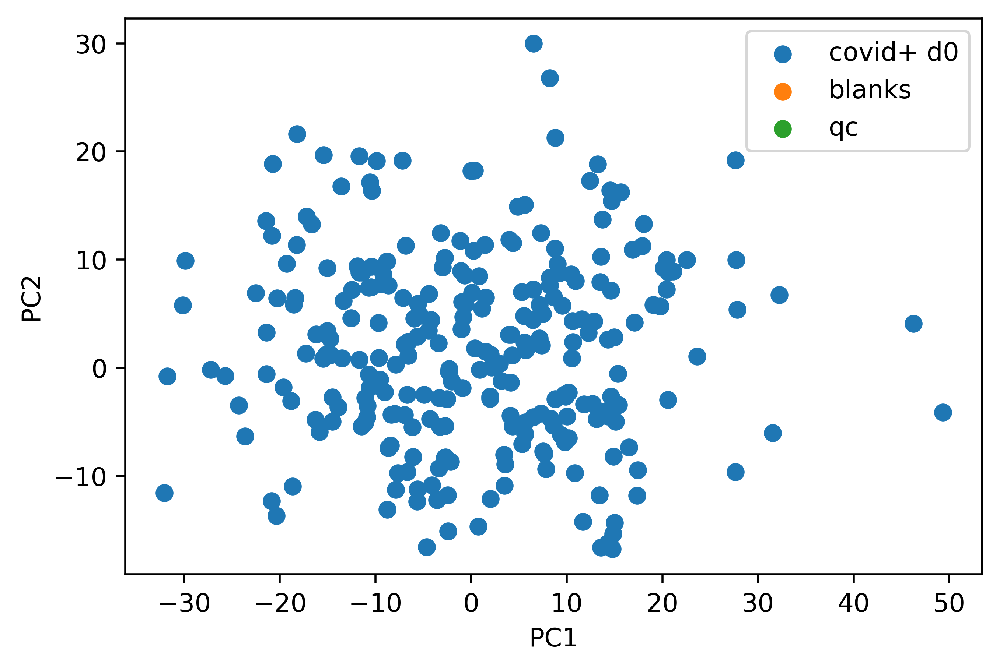

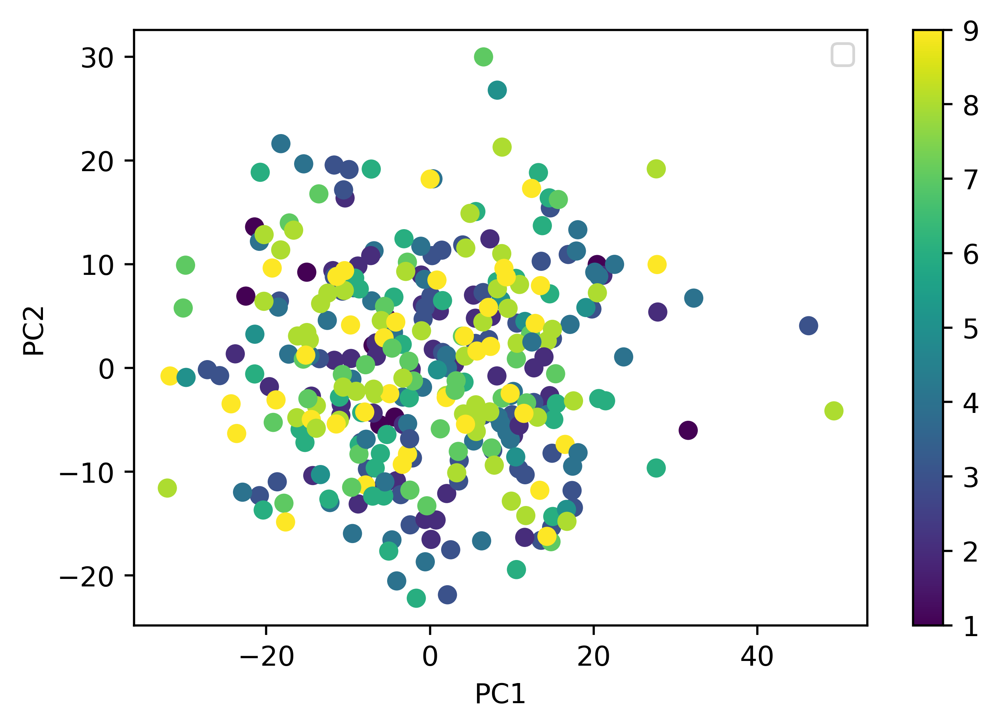

In [3]:
#visualize complete dataset

#first impute dataset
d_whole = np.concatenate((samp_int,blank_int,qc_int,val_int))
d_whole_imput = helper.imputeRowMin(d_whole)

#log2 normalize
d_whole_imput = np.log2(d_whole_imput) 

#do pca 
pca = PCA(n_components=2)
pca.fit(d_whole_imput)
loads = pca.transform(d_whole_imput)

samp_load = loads[:len(samp_int)]
blank_load = loads[len(samp_int):len(samp_int)+len(blank_int)]
qc_load = loads[len(samp_int)+len(blank_int):len(samp_int)+len(blank_int)+len(qc_int)]

#make pca plot divided by sample type
plt.scatter(samp_load[:,0],samp_load[:,1],label="covid+ d0")
plt.scatter(blank_load[:,0],blank_load[:,1],label="blanks")
plt.scatter(qc_load[:,0],qc_load[:,1],label="qc")
plt.legend()
plt.xlabel("PC1")
plt.ylabel("PC2")

#make pca plot by batch
plt.figure()
batch_con = np.concatenate((samp_batch,blank_batch,qc_batch,val_batch))
plt.scatter(loads[:,0],loads[:,1],c=batch_con)
plt.colorbar()
plt.legend()
plt.xlabel("PC1")
plt.ylabel("PC2")


No handles with labels found to put in legend.


Text(0, 0.5, 'PC2')

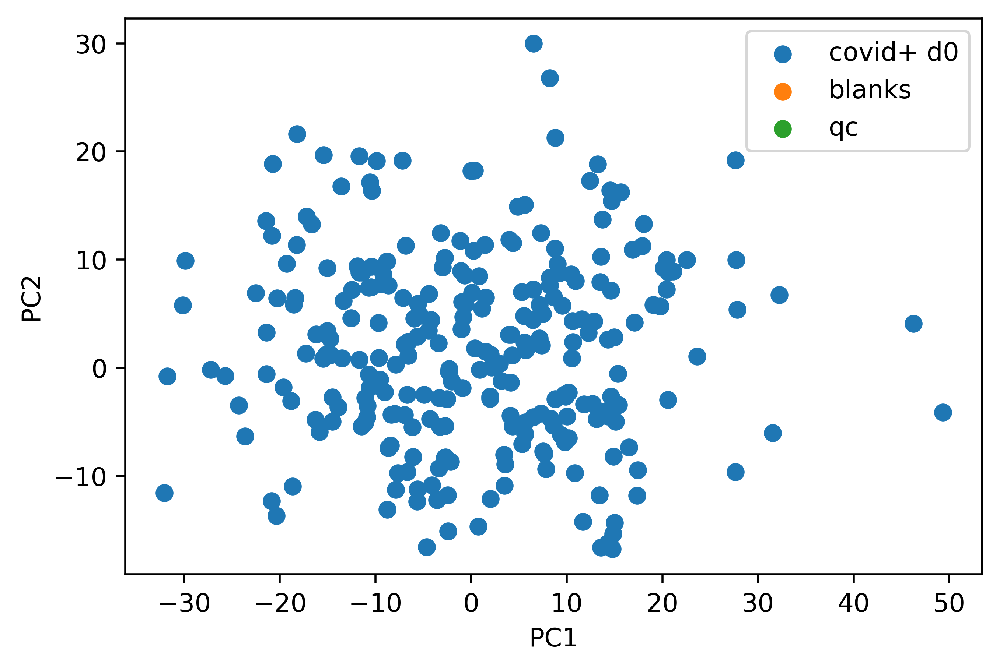

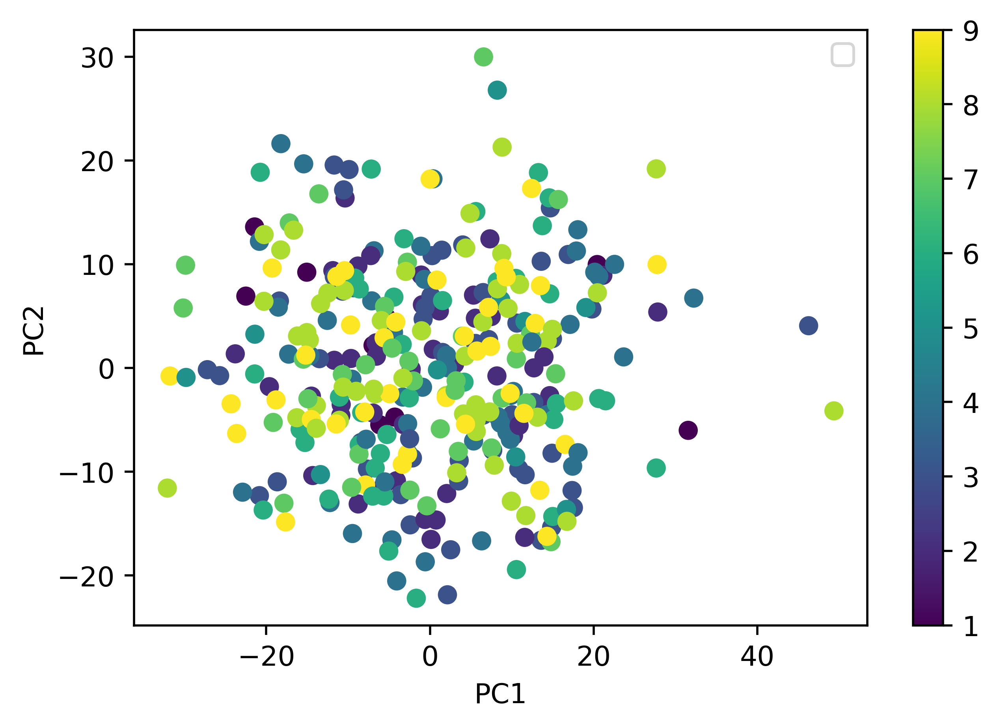

In [4]:
#now quantile normalize

d_whole_norm = d_whole_imput#combat.combat(pd.DataFrame(d_whole_imput.transpose()),np.concatenate((samp_batch,blank_batch,qc_batch,val_batch))).transpose().to_numpy()


#baseline

# if baseline == "qc":
#     # #baseline to qcSamps
#     baseInt = [np.median(x) for x in d_whole_norm[len(samp_int) + len(blank_int):].transpose()]
#     d_whole_norm = np.array([[v - med for v, med in zip(row, baseInt)] for row in d_whole_norm])

# if baseline == "all":
#     baseInt = [np.median(x) for x in d_whole_norm.transpose()]
#     d_whole_norm = np.array([[v - med for v, med in zip(row, baseInt)] for row in d_whole_norm])




#do pca 
pca = PCA(n_components=2)
pca.fit(d_whole_norm)
loads = pca.transform(d_whole_norm)

samp_load = loads[:len(samp_int)]
blank_load = loads[len(samp_int):len(samp_int)+len(blank_int)]
qc_load = loads[len(samp_int)+len(blank_int):len(samp_int)+len(blank_int)+len(qc_int)]

#make pca plot divided by sample type
plt.scatter(samp_load[:,0],samp_load[:,1],label="covid+ d0")
plt.scatter(blank_load[:,0],blank_load[:,1],label="blanks")
plt.scatter(qc_load[:,0],qc_load[:,1],label="qc")
plt.legend()
plt.xlabel("PC1")
plt.ylabel("PC2")

#make pca plot by batch
plt.figure()
batch_con = np.concatenate((samp_batch,blank_batch,qc_batch,val_batch))
plt.scatter(loads[:,0],loads[:,1],c=batch_con)
plt.colorbar()
plt.legend()
plt.xlabel("PC1")
plt.ylabel("PC2")



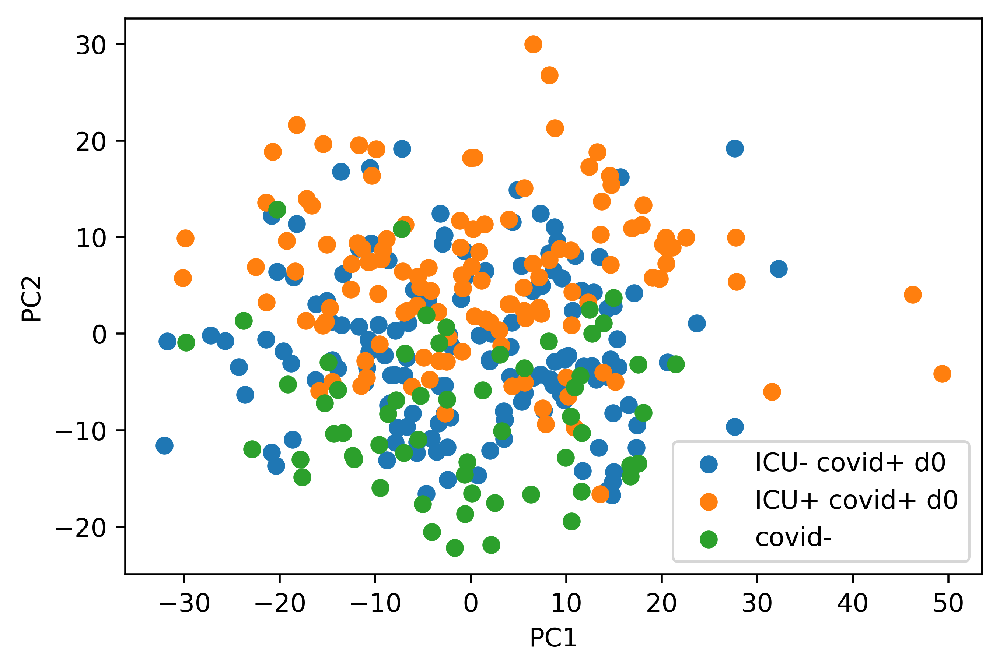

<Figure size 3000x2000 with 0 Axes>

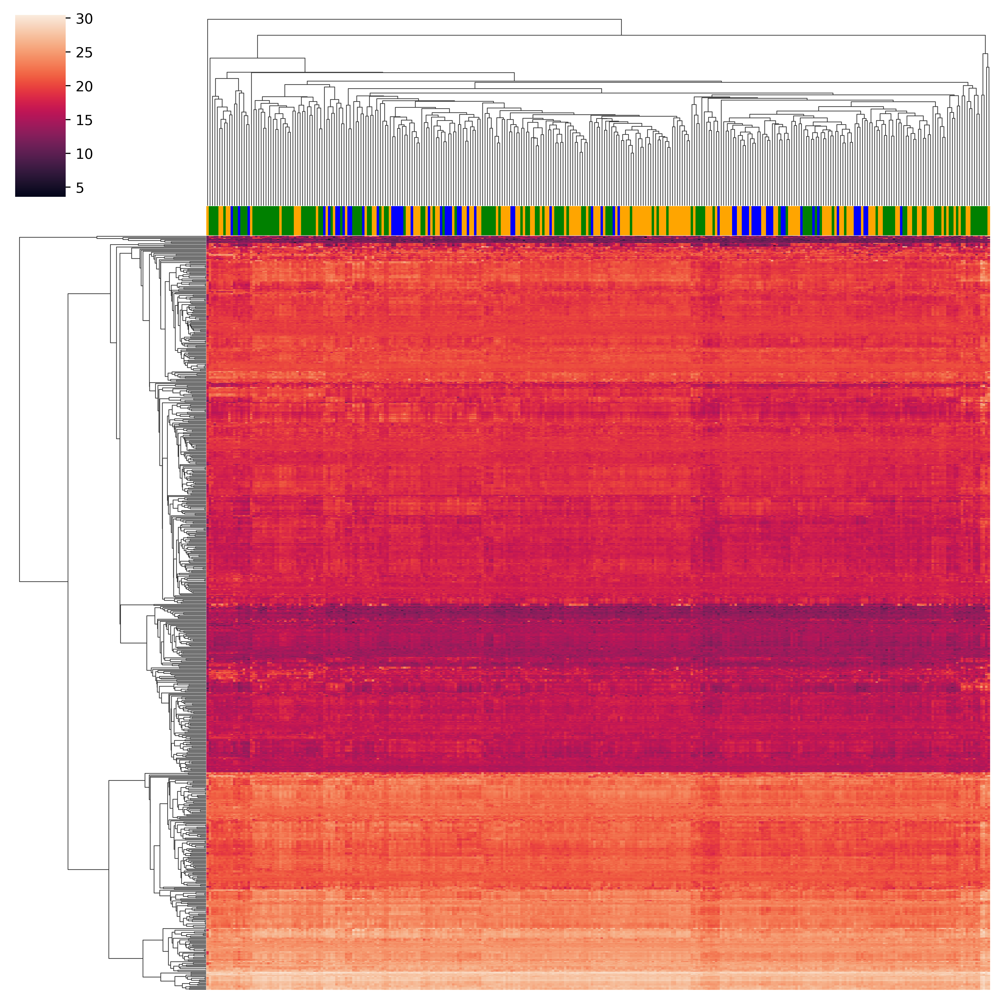

In [5]:
#now plot research samples by vent status
#do pca 
pca = PCA(n_components=2)
pca.fit(d_whole_norm)
loads = pca.transform(d_whole_norm)

#get vent pos/neg loadings
negSamples = [x for x in range(len(samp_vent)) if samp_vent[x] == 0]
posSamples = [x for x in range(len(samp_vent)) if samp_vent[x] == 1]
samp_load_vent_neg = loads[:len(samp_int)][negSamples]
samp_load_vent_pos = loads[:len(samp_int)][posSamples]

#get blanks and qc
blank_load = loads[len(samp_int):len(samp_int)+len(blank_int)]
qc_load = loads[len(samp_int)+len(blank_int):len(samp_int)+len(blank_int)+len(qc_int)]
val_load = loads[len(samp_int)+len(blank_int)+len(qc_int):]

#make pca plot divided by sample type
plt.scatter(samp_load_vent_neg[:,0],samp_load_vent_neg[:,1],label="ICU- covid+ d0")
plt.scatter(samp_load_vent_pos[:,0],samp_load_vent_pos[:,1],label="ICU+ covid+ d0")
#plt.scatter(blank_load[:,0],blank_load[:,1],label="blanks")
#plt.scatter(qc_load[:,0],qc_load[:,1],label="qc")
plt.scatter(val_load[:,0],val_load[:,1],label="covid-")
plt.legend()
plt.xlabel("PC1")
plt.ylabel("PC2")

plt.figure()

colors = ["blue" for _ in d_whole_norm]
for x in negSamples:
    colors[x] = "orange"
for x in posSamples:
    colors[x] = "green"
sb.clustermap(d_whole_norm.transpose(),xticklabels=False,yticklabels=False,col_colors=colors)

In [6]:
#create train and test sets for prediction model

#train batches on 1-4
#test on 5-6

trainBatches = [1,2,3,4,5,6]
testBatches = [7,8,9]


#get blanks for train/test
blank_train_index = [x for x in range(len(blank_batch)) if blank_batch[x] in trainBatches]
blank_test_index = [x for x in range(len(blank_batch)) if blank_batch[x] in testBatches]

blank_train_int = blank_int[blank_train_index]
blank_test_int = blank_int[blank_test_index]

blank_train_batch = blank_batch[blank_train_index]
blank_test_batch = blank_batch[blank_test_index]

#get samples for train/test
samp_train_index = [x for x in range(len(samp_batch)) if samp_batch[x] in trainBatches]
samp_test_index = [x for x in range(len(samp_batch)) if samp_batch[x] in testBatches]

samp_train_int = samp_int[samp_train_index]
samp_test_int = samp_int[samp_test_index]

samp_train_vent = samp_vent[samp_train_index]
samp_test_vent = samp_vent[samp_test_index]

samp_train_batch = samp_batch[samp_train_index]
samp_test_batch = samp_batch[samp_test_index]

samp_train_metadata = [samp_metadata[x] for x in samp_train_index]
samp_test_metadata = [samp_metadata[x] for x in samp_test_index]

samp_train_measurements = [samp_measurement[x] for x in samp_train_index]
samp_test_measurements = [samp_measurement[x] for x in samp_test_index]

#get qc for train/test

qc_train_index = [x for x in range(len(qc_batch)) if qc_batch[x] in trainBatches]
qc_test_index = [x for x in range(len(qc_batch)) if qc_batch[x] in testBatches]

qc_train_int = qc_int[qc_train_index]
qc_test_int = qc_int[qc_test_index] 

qc_train_batch = qc_batch[qc_train_index]
qc_test_batch = qc_batch[qc_test_index] 

#need to add vent and qcs

print("training examples: ",len(samp_train_int),"testing examples: ",len(samp_test_int))
print("training ICU+ examples:, ",len([x for x in samp_train_vent if x == 1]),
      "training ICU- examples:, ",len([x for x in samp_train_vent if x == 0]))
print("testing ICU+ examples:, ",len([x for x in samp_test_vent if x == 1]),
      "testing ICU- examples:, ",len([x for x in samp_test_vent if x == 0]))

training examples:  163 testing examples:  100
training ICU+ examples:,  83 training ICU- examples:,  80
testing ICU+ examples:,  40 testing ICU- examples:,  60


In [7]:
# X_train,y_train,X_test,y_test,X_train_blank = samp_train_int,samp_train_vent,samp_test_inthelper.normalize_data(samp_train_int,blank_train_int,qc_train_int,np.concatenate((samp_test_int,val_int,samp_confirm_int)), blank_test_int, qc_test_int,samp_train_batch,
#                            blank_train_batch, qc_train_batch, np.concatenate((samp_test_batch,val_batch,samp_confirm_batch)), blank_test_batch, qc_test_batch,samp_train_vent,np.concatenate((samp_test_vent,val_vent,samp_confirm_vent)),baseline)
# X_test,X_val,X_confirm = X_test[:len(samp_test_batch)],X_test[len(samp_test_batch):len(samp_test_batch)+len(val_batch)],X_test[len(samp_test_batch)+len(val_batch):]
# y_test,y_val,y_confirm = y_test[:len(samp_test_batch)],y_test[len(samp_test_batch):len(samp_test_batch)+len(val_batch)],y_test[len(samp_test_batch)+len(val_batch):]

X_train = np.log2(samp_train_int)
y_train = samp_train_vent

X_test = np.log2(samp_test_int)
y_test = samp_test_vent

X_train_blank = np.log2(blank_train_int)

X_val = np.log2(val_int)
y_val = val_vent


X_train_metadata = samp_train_metadata
X_test_metadata = samp_test_metadata

X_train_measurement = samp_train_measurements
X_test_measurement = samp_test_measurements



In [8]:
#set number of processors (n) and number of splits (k)
k = 20#20#len(samp_train_int)
n = 20
fc_to_test = [1]
alpha_to_test = [1e-3,1e-2,0.05,0.10,1.0]
methods = ["corr","stat"]
num_corr = np.linspace(0,1,10)
feat_params = []
for meth in methods:
    if meth == "corr":
        for nc in num_corr:
            feat_params.append((meth,nc))
    elif meth == "stat":
        for a in alpha_to_test:
            for fc in fc_to_test:
                feat_params.append((meth,a,fc))

#define model names, functions, and hyper parameters to test
model_names = ["Logistic Regression","ElasticNet","PLSDA","SVM","Random Forest"]
model_parameter_lists = [{"feat_selection":feat_params,"C":[0.001,0.01,.1,10,100],"l1_ratio":np.linspace(0,1,10)},
                         {"feat_selection":feat_params,"alpha":[0.001,0.01,.1,1,10,100],"l1_ratio":np.linspace(0,1,10)},
                         {"feat_selection":feat_params,"n_components":range(3,10)},
                         {"feat_selection":feat_params,"C":[1e-3,1e-2,1e-1,1,10,100],"kernel":["linear","poly","rbf","sigmoid"]},
                         {"feat_selection":feat_params,"max_features":["auto","log2",None],"max_depth":[None,1,5,10,20,50],"n_estimators": [int(x) for x in np.linspace(1,200,5)]}]

model_train_funcs = [helper.trainLogisticRegression,helper.trainElasticNet,helper.trainPLSDA,helper.trainSVM,helper.trainRF]
model_predict_funcs = [helper.predictLogisticRegression,helper.predictElasticNet,helper.predictPLSDA,helper.predictSVM,helper.predictRF]

#structure to store results
modeling_results_dict = {}
modeling_results_dict_training = {}
index = 0

if __name__ ==  '__main__': 
    #iterate over baselining methods
    for baseline in ["none"]:#,"all"]:
        
        #get normalized training and testing data
        
        #iterate over model types
        for name,paramsToTry,trainFunc,predictFunc in zip(model_names,model_parameter_lists,model_train_funcs,model_predict_funcs):

            #optimize hyper parameters        
            results,err_cv,bestParams,log_pred = helper.optimizeHyperParams(paramsToTry,X_train,y_train,X_train_blank,mol_names,trainFunc,predictFunc,k=k,n=n)
            print(baseline,name)
            #get best parameters
            print(bestParams)
            plt.figure()
            selected_feats = helper.featureSelection(X_train,y_train,X_train_blank,mol_names,bestParams["feat_selection"],False,False)

            y_pred = predictFunc(log_pred,X_train)

            #assess training error
            err_train = helper.score(y_pred,y_train)
            print("training score: ",err_train)

            #print(sklearn.metrics.confusion_matrix(y_train,y_pred))

            #assess cross validation error
            y_pred,y_true = helper.crossVal(X_train,y_train,X_train_blank,mol_names,trainFunc,predictFunc,bestParams,k=k,numCores=n)

            err_cv = helper.score(y_pred,y_true)
            print("cv score: ",err_cv)
            #print(sklearn.metrics.confusion_matrix(y_true,y_pred))
            modeling_results_dict[index] = {"Model":name,"Params":bestParams,"Baseline":baseline,"Score":err_cv,"Training Score":err_train}

            index += 1
            
results = pd.DataFrame.from_dict(modeling_results_dict,orient="index")
pkl.dump(results,open("modeling_results_qTOF_ICU_new_test.pkl","wb"))

none Logistic Regression
{'feat_selection': ('corr', 0.4444444444444444), 'C': 10, 'l1_ratio': 0.4444444444444444}
training score:  0.8617469879518072
cv score:  0.8001506024096385
none ElasticNet
{'feat_selection': ('corr', 0.3333333333333333), 'alpha': 10, 'l1_ratio': 0.0}
training score:  0.8799698795180723
cv score:  0.8003012048192772
none PLSDA
{'feat_selection': ('corr', 0.8888888888888888), 'n_components': 4}
training score:  0.9727409638554217
cv score:  0.7808734939759036
none SVM
{'feat_selection': ('corr', 0.2222222222222222), 'C': 0.1, 'kernel': 'rbf'}
training score:  0.7375753012048193
cv score:  0.7190512048192772
none Random Forest
{'feat_selection': ('corr', 0.5555555555555556), 'max_features': 'log2', 'max_depth': None, 'n_estimators': 100}
training score:  1.0
cv score:  0.6993975903614458


<Figure size 3000x2000 with 0 Axes>

<Figure size 3000x2000 with 0 Axes>

<Figure size 3000x2000 with 0 Axes>

<Figure size 3000x2000 with 0 Axes>

<Figure size 3000x2000 with 0 Axes>

                 Model                                             Params  \
0  Logistic Regression  {'feat_selection': ('corr', 0.4444444444444444...   
1           ElasticNet  {'feat_selection': ('corr', 0.3333333333333333...   
2                PLSDA  {'feat_selection': ('corr', 0.8888888888888888...   
3                  SVM  {'feat_selection': ('corr', 0.2222222222222222...   
4        Random Forest  {'feat_selection': ('corr', 0.5555555555555556...   

  Baseline     Score  Training Score  
0     none  0.800151        0.861747  
1     none  0.800301        0.879970  
2     none  0.780873        0.972741  
3     none  0.719051        0.737575  
4     none  0.699398        1.000000  
        Model                                             Params Baseline  \
1  ElasticNet  {'feat_selection': ('corr', 0.3333333333333333...     none   

      Score  Training Score  
1  0.800301         0.87997  
{'feat_selection': ('corr', 0.3333333333333333), 'alpha': 10, 'l1_ratio': 0.0}


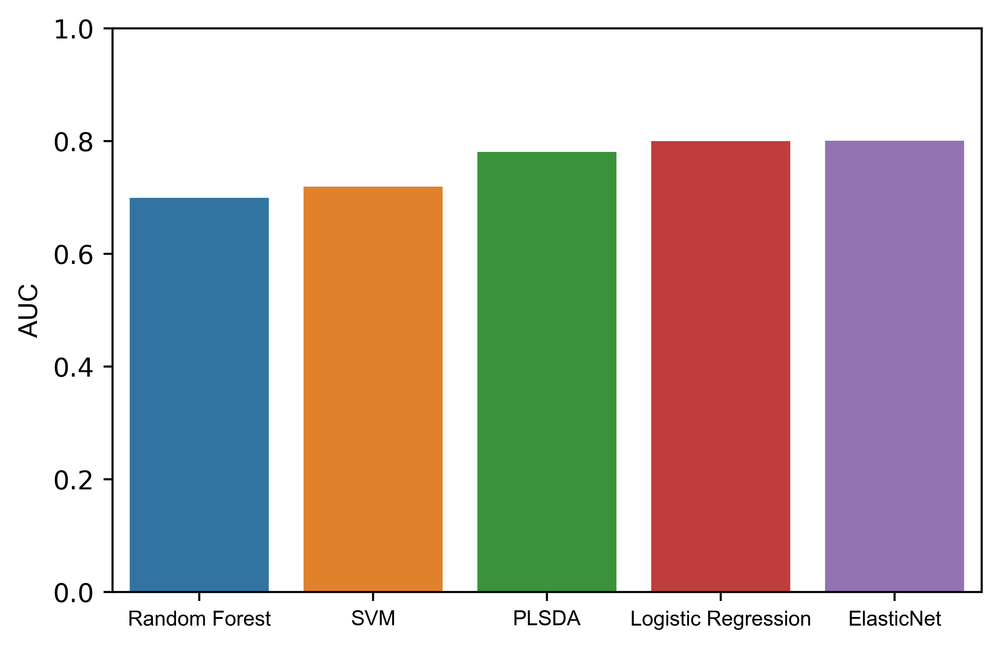

In [9]:
results = pkl.load(open("modeling_results_qTOF_ICU_new_test.pkl","rb"))
#plot results
print(results)

results = results[results["Baseline"] == "none"]
results = results.sort_values(by="Score")
sb.barplot(x="Model",y="Score",data=results)
plt.xticks(fontsize=8)
plt.ylim((0,1))

#print(results)
results = results[results["Score"] < results["Training Score"]]
#results = results[results["Score"] > results["Training Score"] * 2/3]
bestParams = results[results["Score"] == results["Score"].max()]
ind = bestParams.index.values[0]
print(bestParams)
print(bestParams.at[ind,"Params"])
baseline = bestParams.at[ind,"Baseline"]
params = bestParams.at[ind,"Params"]
model = bestParams.at[ind,"Model"]
model_names = ["Logistic Regression","ElasticNet","PLSDA","SVM","Random Forest"]
model_train_funcs = [helper.trainLogisticRegression,helper.trainElasticNet,helper.trainPLSDA,helper.trainSVM,helper.trainRF]
model_predict_funcs = [helper.predictLogisticRegression,helper.predictElasticNet,helper.predictPLSDA,helper.predictSVM,helper.predictRF]
train_mapping = {name:func for name,func in zip(model_names,model_train_funcs)}
predict_mapping = {name:func for name,func in zip(model_names,model_predict_funcs)}

trainFunc,predictFunc = train_mapping[model],predict_mapping[model]
plt.ylabel("AUC",fontfamily="Arial")
plt.xlabel("")
plt.xticks(fontfamily="Arial")
plt.savefig("../manuscript_figs/model_selection_bar.png")




training score:  0.8799698795180723
testing score:  0.72375


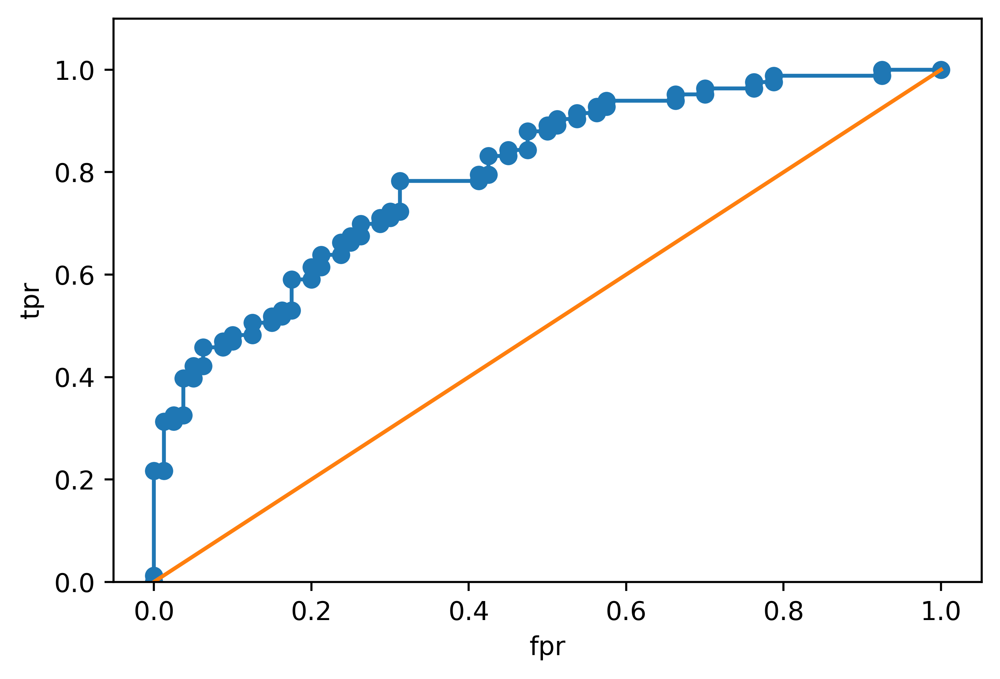

In [10]:
#fit model
feat_params = params["feat_selection"]

y_pred_cv,y_cv = helper.crossVal(X_train,y_train,X_train_blank,mol_names,trainFunc,predictFunc,params,k=20,numCores=20)

selected_feats = helper.featureSelection(X_train,y_train,X_train_blank,mol_names,feat_params,True,True)
X_train_sig = X_train[:,selected_feats]
obj = trainFunc(X_train, y_train, X_train_blank, mol_names, params)

#predict
y_pred_train = predictFunc(obj,X_train)

#assess training error
err_train = helper.score(y_pred_train,y_train)
print("training score: ",err_train)
#print(sklearn.metrics.confusion_matrix(y_train,y_pred))

plt.figure()

fpr,tpr,thresolds = sklearn.metrics.roc_curve(y_cv,y_pred_cv)
plt.plot(fpr,tpr)
plt.scatter(fpr,tpr)
plt.xlabel("fpr")
plt.ylabel("tpr")
plt.ylim((0,1.1))
plt.plot([0,1],[0,1])
# for p,r,t in zip(precision,recall,thresolds):
#     print(p,r,t)

#assess testing error
y_test_pred = predictFunc(obj,X_test)

err_test = helper.score(y_test_pred,y_test)
print("testing score: ",err_test)
#print(sklearn.metrics.confusion_matrix(y_test,y_test_pred))

y_neg_pred = [y_test_pred[i] for i in range(len(y_test_pred)) if y_test[i] < .5]
y_pos_pred = [y_test_pred[i] for i in range(len(y_test_pred)) if y_test[i] > .5]

y_val_pred = predictFunc(obj,X_val)

    





In [11]:
outdict = {}
ind += 1
for col in measurement_data.columns.values:
    clinical = []
    tmp = [r[col] for r in X_test_measurement]
    trues = []
    preds = []
    for comorb,true,pred in zip(tmp,y_test,y_test_pred):
        if not pd.isna(comorb):
            if type(comorb) == type(""):
                comorb = comorb.replace("<","").replace(">","")
            if float(comorb) > -.5:
                clinical.append(float(comorb))
                trues.append(true)
                preds.append(pred)
                
    if len(trues) > 0:
        #fpr,tpr,thresolds = sklearn.metrics.roc_curve(trues,clinical)
        #plt.plot(fpr,tpr,c="red",label=col)
        #plt.scatter(fpr,tpr,c="red")
        #fpr,tpr,thresolds = sklearn.metrics.roc_curve(trues,preds)
        #plt.plot(fpr,tpr,c="blue",label = "Model")
        #plt.scatter(fpr,tpr,c="blue")
        #plt.xlabel("fpr")
        #plt.ylabel("tpr")
        #plt.ylim((0,1.1))
        #plt.plot([0,1],[0,1])
        #plt.title(col)
        #plt.figure()
        score = helper.score(clinical,trues)
        scoreRev = helper.score(np.array(clinical) * -1,trues)
        score = max([score,scoreRev])

        scoreModel = helper.score(preds,trues)
        outdict[ind] = {"value":col,"auc_val":score,"auc_model":scoreModel,"relative_auc":score/scoreModel,"n":len(trues)}
        ind += 1
    
pd.DataFrame.from_dict(outdict,orient="index").to_csv("clinical_v_model_full.csv",index=False)

2


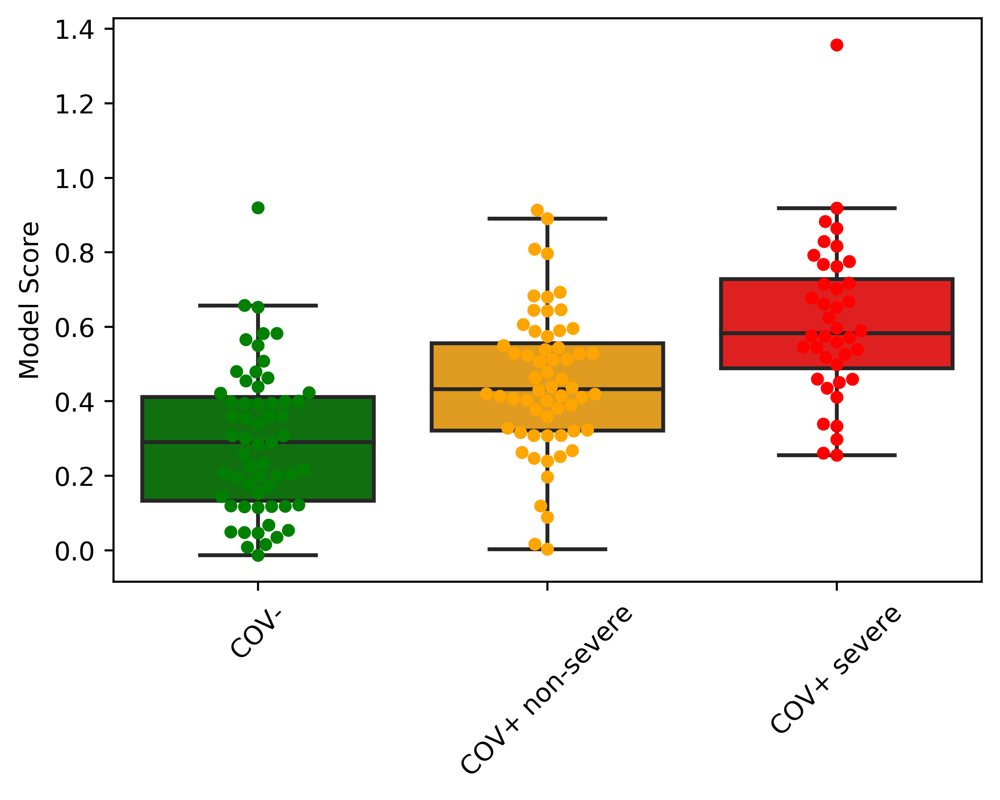

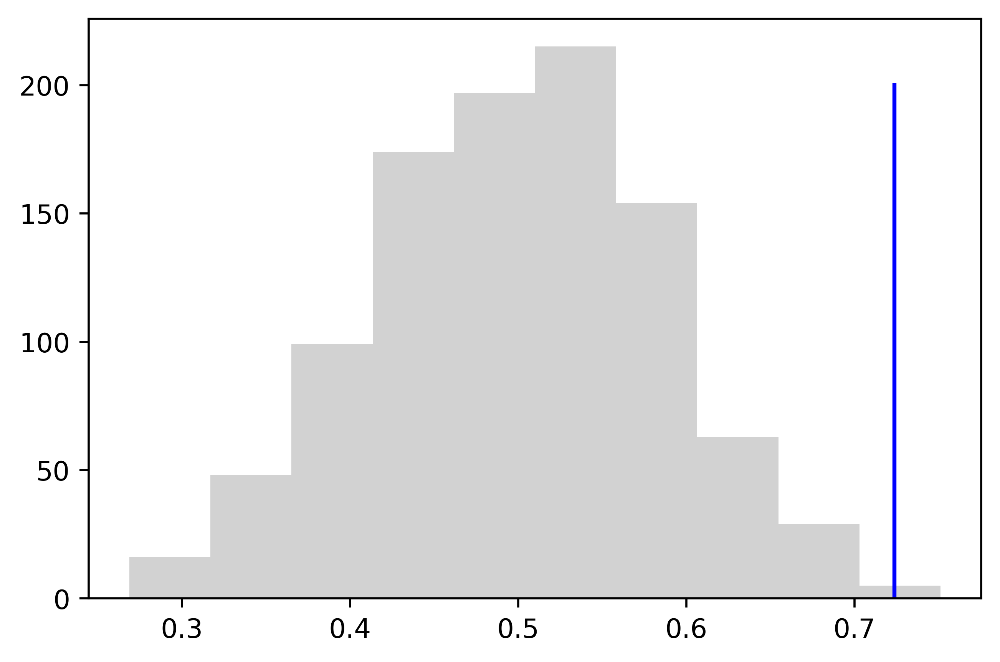

In [12]:
thresh = 0.56
plot_df = {}
ind = 0
for x in y_val_pred:
    plot_df[ind] = {"Status":"COV-","Model Score":x}
    ind += 1

for x in y_neg_pred:
    plot_df[ind] = {"Status":"COV+ non-severe","Model Score":x}
    ind += 1

for x in y_pos_pred:
    plot_df[ind] = {"Status":"COV+ severe","Model Score":x}
    ind += 1

plot_df = pd.DataFrame.from_dict(plot_df,orient="index")
sb.boxplot(data=plot_df,x="Status",y="Model Score",fliersize=0,palette={"COV-":"green",
                                                                        "COV+ non-severe":"orange",
                                                                        "COV+ severe":"red"})

sb.swarmplot(data=plot_df,x="Status",y="Model Score",palette={"COV-":"green",
                                                                        "COV+ non-severe":"orange",
                                                                        "COV+ severe":"red"},dodge=True)
plt.xticks(rotation=45)
plt.xlabel("")
plt.savefig("../manuscript_figs/full_prediction_model_box_swarm.png")
#plt.plot(range(1,4),[thresh for _ in range(1,4)])

#y_val_pred_bin = binarize(y_val_pred,thresh)
#y_test_pred_bin = binarize(y_test_pred,thresh)

# print(sklearn.metrics.confusion_matrix(y_val,y_val_pred_bin))
# print(sklearn.metrics.confusion_matrix(y_test,y_test_pred_bin))



#permutation test
numPerm = 1000 #change to 10000
res = []
fprs_tprs = []
for _ in range(numPerm):
    order = list(range(len(y_train)))
    rd.shuffle(order)
    y_shuff = np.array([y_train[x] for x in order])
    obj = trainFunc(X_train, y_shuff, X_train_blank, mol_names, params)
    y_pred = predictFunc(obj,X_test)
    err_shuff = helper.score(y_pred,y_test)
    res.append(err_shuff)
    fpr,tpr,_ = sklearn.metrics.roc_curve(y_test,y_pred)
    fprs_tprs.append([fpr,tpr])
    
print(len([x for x in res if x > err_test]))
    
#plot histogram
plt.figure()
plt.hist(res,color="grey",alpha=.35)
plt.plot([err_test,err_test],[0,.2*numPerm],color="blue")
plt.xlabel("")
plt.savefig("../manuscript_figs/full_prediction_model_permutation_hist.png")


Ttest_indResult(statistic=-5.778437581858974, pvalue=2.1467109218841578e-08)
Ttest_indResult(statistic=1.5764301529833187, pvalue=0.11615317758014433)
0.5966666666666667


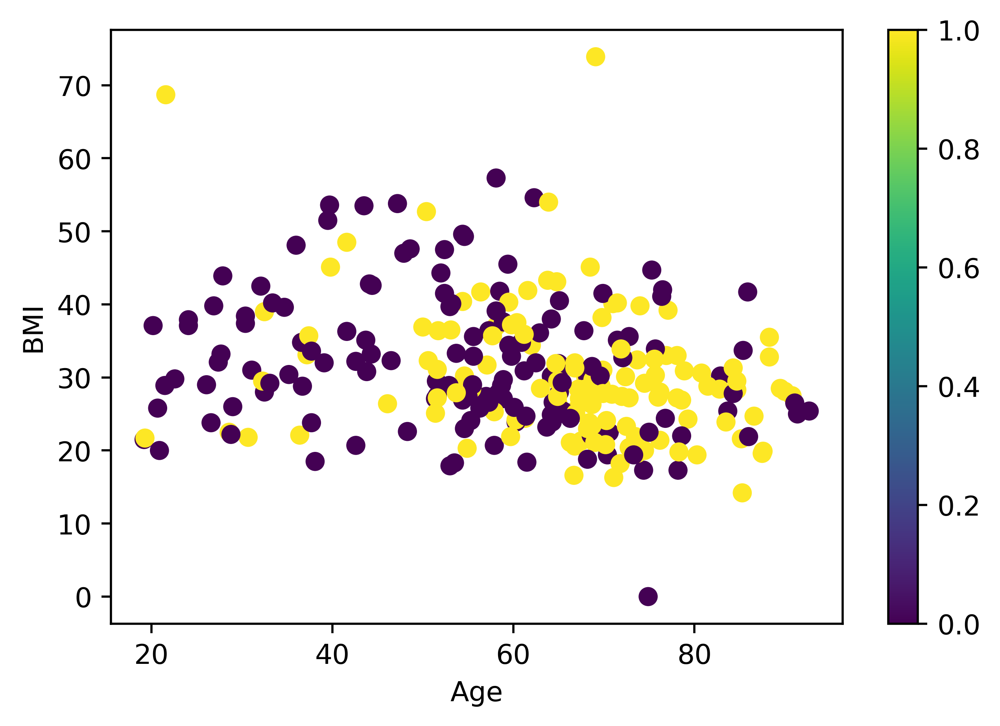

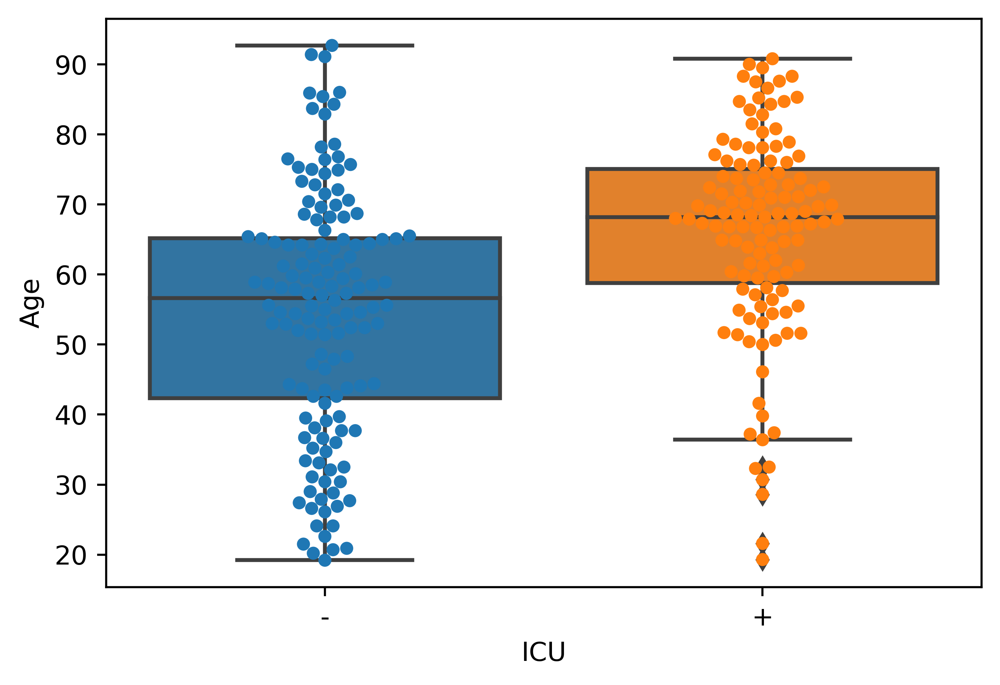

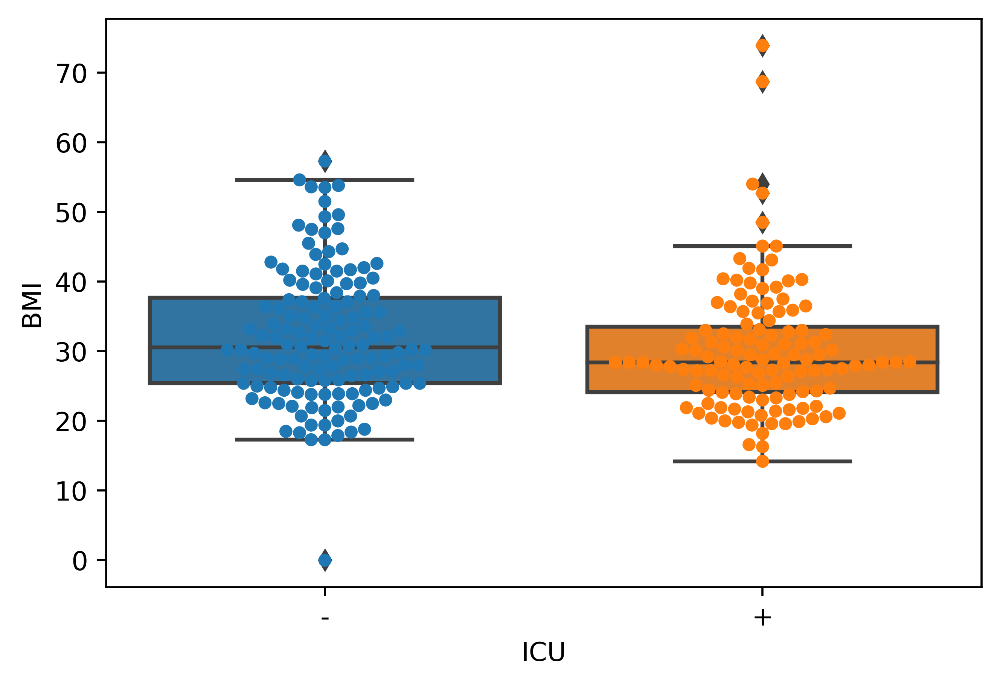

In [13]:
good_train_ind = []
for x,i in zip(X_train_metadata,range(len(X_train_metadata))):
    try: 
        float(x["Age at Symptom onset (years)"])
        float(x["BMI"])
        good_train_ind.append(i)
    except:
        pass
    
        
good_test_ind = []
for x,i in zip(X_test_metadata,range(len(X_test_metadata))):
    try: 
        float(x["Age at Symptom onset (years)"])
        float(x["BMI"])
        good_test_ind.append(i)
    except:
        pass
        


X_train_age = [float(x["Age at Symptom onset (years)"]) for x,i in zip(X_train_metadata,range(len(X_train_metadata))) if i in good_train_ind]
X_test_age = [float(x["Age at Symptom onset (years)"]) for x,i in zip(X_test_metadata,range(len(X_test_metadata))) if i in good_test_ind]
X_train_bmi = [float(x["BMI"]) for x,i in zip(X_train_metadata,range(len(X_train_metadata))) if i in good_train_ind]
X_test_bmi = [float(x["BMI"]) for x,i in zip(X_test_metadata,range(len(X_test_metadata))) if i in good_test_ind]
X_train_baseline = np.array([X_train_age,X_train_bmi]).transpose()
X_test_baseline = np.array([X_test_age,X_test_bmi]).transpose()

y_train_baseline = y_train[good_train_ind]
y_test_baseline = y_test[good_test_ind]

y_baseline = np.concatenate((y_train_baseline,y_test_baseline))

X_baseline = np.concatenate((X_train_baseline,X_test_baseline))
plt.scatter(X_baseline[:,0],X_baseline[:,1],c=y_baseline)
plt.xlabel("Age")
plt.ylabel("BMI")

negSamples_X_baseline = np.array([x for x,yy in zip(X_baseline,y_baseline) if yy < .5])
posSamples_X_baseline = np.array([x for x,yy in zip(X_baseline,y_baseline) if yy > .5])

plt.colorbar()

plt.figure()

plot_dict = {}
ind = 0
for samp in negSamples_X_baseline:
    plot_dict[ind] = {"ICU":"-","Age":samp[0],"BMI":samp[1]}
    ind += 1
    
for samp in posSamples_X_baseline:
    plot_dict[ind] = {"ICU":"+","Age":samp[0],"BMI":samp[1]}
    ind += 1

plot_df = pd.DataFrame.from_dict(plot_dict,orient="index")

sb.boxplot(data=plot_df,x="ICU",y="Age")
sb.swarmplot(data=plot_df,x="ICU",y="Age")

plt.figure()

sb.boxplot(data=plot_df,x="ICU",y="BMI")
sb.swarmplot(data=plot_df,x="ICU",y="BMI")

print(stats.ttest_ind(negSamples_X_baseline[:,0],posSamples_X_baseline[:,0],equal_var=False))
print(stats.ttest_ind(negSamples_X_baseline[:,1],posSamples_X_baseline[:,1],equal_var=False))

log_reg = sklearn.linear_model.LinearRegression(fit_intercept=True)
log_reg.fit(X_train_baseline,y_train_baseline)

pred_baseline = log_reg.predict(X_test_baseline)

print(helper.score(pred_baseline,y_test_baseline))

[0.0, 0.21666666666666667, 0.23333333333333334, 0.26666666666666666, 0.38333333333333336, 0.5, 0.5166666666666667, 0.5833333333333334, 0.016666666666666666, 0.55, 1.0, 0.25, 0.2833333333333333, 0.75, 0.7833333333333333, 0.5333333333333333, 0.03333333333333333, 0.5666666666666667, 0.31666666666666665, 0.8166666666666667, 0.85, 0.6, 0.35, 0.7166666666666667, 0.9666666666666667, 0.06666666666666667, 0.08333333333333333, 0.6333333333333333, 0.05, 0.8833333333333333, 0.9166666666666666, 0.6666666666666666, 0.4166666666666667, 0.95, 0.7, 0.45, 0.2, 0.9833333333333333, 0.7333333333333333, 0.48333333333333334, 0.1, 0.15, 0.18333333333333332, 0.11666666666666667, 0.16666666666666666, 0.13333333333333333, 0.7666666666666667, 0.3, 0.8, 0.3333333333333333, 0.8333333333333334, 0.36666666666666664, 0.8666666666666667, 0.6166666666666667, 0.65, 0.9, 0.4, 0.9333333333333333, 0.43333333333333335, 0.6833333333333333, 0.4666666666666667]


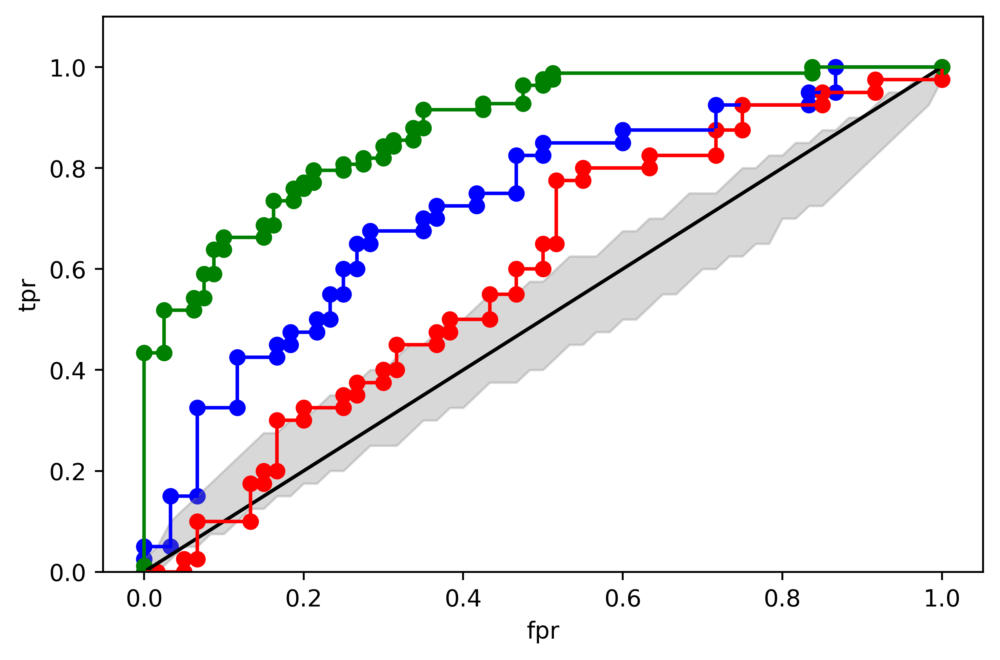

In [14]:
fpr,tpr,thresolds = sklearn.metrics.roc_curve(y_test,y_test_pred)
plt.plot(fpr,tpr,color="blue")
plt.scatter(fpr,tpr,color="blue")
plt.xlabel("fpr")
plt.ylabel("tpr")
plt.ylim((0,1.1))
plt.plot([0,1],[0,1],color="black")

fprs = np.array([])
for fpr,tpr in fprs_tprs:
    fprs = np.concatenate((fprs,fpr))
fprs = list(set(fprs))    
print(fprs)
matched_vals = {fpr:[] for fpr in fprs}

for fpr,tpr in fprs_tprs:
    for f,t in zip(fpr,tpr):
        matched_vals[f].append(t)
        
matched_vals = {f:[np.percentile(val,25),np.percentile(val,75)] for f,val in matched_vals.items()}
fpr_rand = list(matched_vals.keys())
fpr_rand.sort()
tpr_min = [matched_vals[f][0] for f in fpr_rand]
tpr_max = [matched_vals[f][1] for f in fpr_rand]

plt.fill_between(fpr_rand,tpr_min,tpr_max,facecolor="grey",color="grey",alpha=.3)


fpr,tpr,thresolds = sklearn.metrics.roc_curve(y_test_baseline,pred_baseline)
plt.plot(fpr,tpr,c="red")
plt.scatter(fpr,tpr,c="red")


fpr,tpr,thresolds = sklearn.metrics.roc_curve(y_train,y_pred_train)
plt.plot(fpr,tpr,c="green")
plt.scatter(fpr,tpr,c="green")

plt.tight_layout()
plt.savefig("../manuscript_figs/ROC_curve_full_model.png")

# fpr,tpr,thresolds = sklearn.metrics.roc_curve(y_cv,y_pred_cv)
# plt.plot(fpr,tpr,c="orange")
# plt.scatter(fpr,tpr,c="orange")



707
235
training score:  0.8799698795180723
707


<Figure size 3000x2000 with 0 Axes>

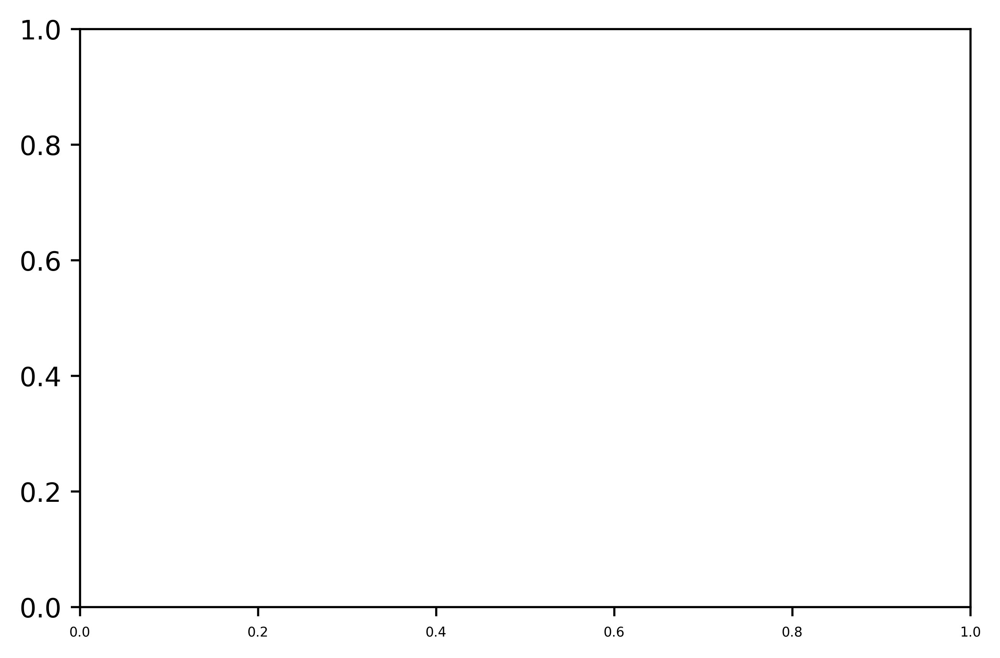

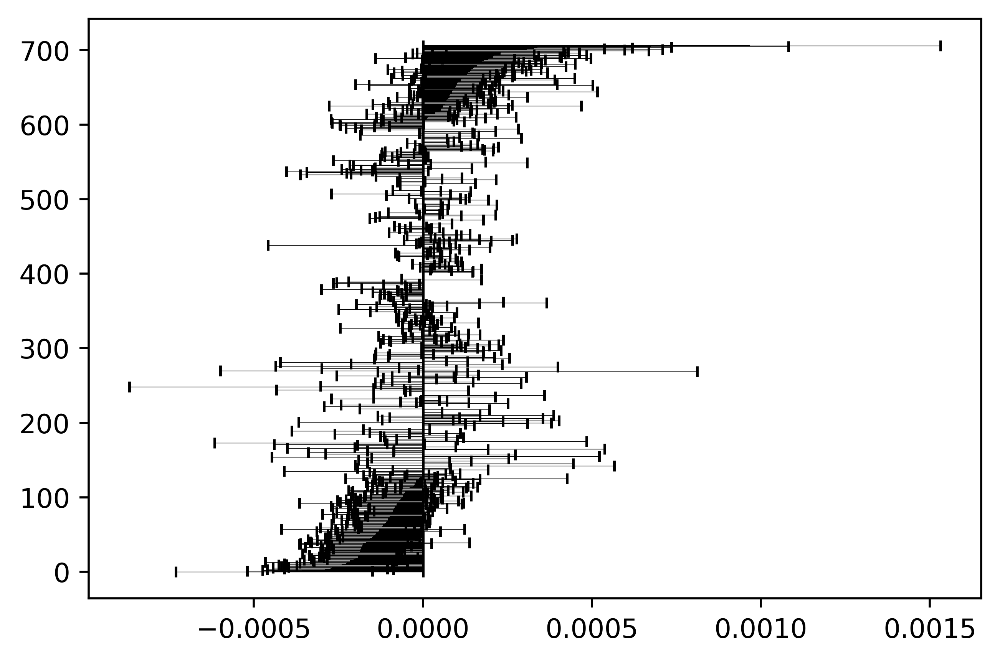

<Figure size 3000x2000 with 0 Axes>

In [15]:

#train on entire dataset
X_blank = X_train_blank

    
plt.figure()
feat_params = params["feat_selection"]
selected_feats = helper.featureSelection(X_train,y_train,X_blank,mol_names,feat_params,True,True)


#bootstrap samples
poss = list(range(len(X_train)))
numBoots = 10000
coefs = np.zeros((numBoots,len(mol_names)))
for x in range(numBoots):
    samp = rd.choices(poss,k=len(poss))
    X_temp = X_train[samp]
    y_temp = y_train[samp]
    obj = trainFunc(X_temp,y_temp,X_blank,mol_names,params)
    coefs[x][obj._selectedvars] = np.array(flatten(obj.coef_.tolist()))
    coefs[x] = np.array([coefs[x][i]/np.median(X_temp[:,i]) for i in range(len(mol_names))])
coefs = np.array(coefs).transpose()
print(len(coefs))

coefs_ci = np.array([(np.percentile(x,2.5),np.percentile(x,97.5)) for x in coefs])

print(len(selected_feats))
obj = trainFunc(X_train, y_train, X_blank, mol_names, params)
y_pred = predictFunc(obj,X_train)
err_train = helper.score(y_pred,y_train)
print("training score: ",err_train)
#print(sklearn.metrics.confusion_matrix(y,y_pred))
plt.xticks(fontsize=5)
plt.figure()


var_imp = np.zeros((len(mol_names)))
var_imp[obj._selectedvars] = np.array(flatten(obj.coef_.tolist()))
var_imp = np.array([var_imp[x]/np.median(X_train[:,x]) for x in range(len(var_imp))])

coefs_ci_normed = np.array([np.abs(r - vi) for r,vi in zip(coefs_ci,var_imp)])
print(len(var_imp))
order = list(range(len(var_imp)))
order.sort(key=lambda x:var_imp[x])
var_imp = var_imp[order]
coefs = coefs[order]
coefs_ci = coefs_ci[order]
coefs_ci_normed = coefs_ci_normed[order]

plt.barh(range(len(var_imp)),width = var_imp,xerr=[coefs_ci_normed[:,0],coefs_ci_normed[:,1]],ecolor="black",capsize=2,error_kw={"elinewidth":0.2,"barsabove":False},color="black")

plt.figure()




96


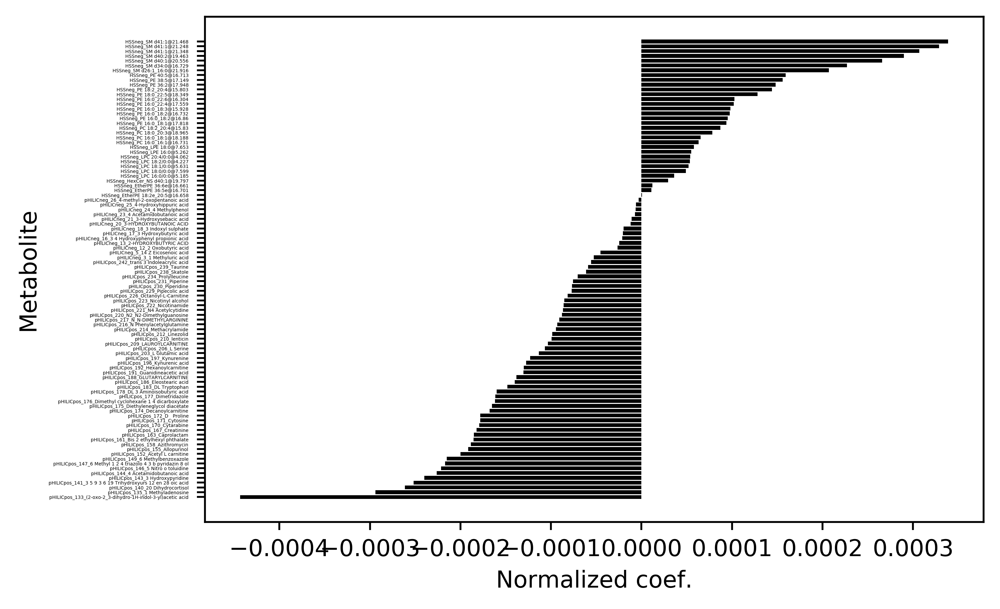

In [16]:
plt.figure()
obj = trainFunc(np.concatenate((X_train,X_test)),np.concatenate((y_train,y_test)),X_train_blank,mol_names,params)
rel = var_imp[obj._selectedvars]
print(len([x for x in rel if np.abs(x) > 0]))
names = mol_names[obj._selectedvars]
o = list(range(len(rel)))
o.sort(key=lambda x:rel[x])
o = [x for x in o if abs(rel[x]) > 0]
rel = rel[o]
names = names[o]
plt.barh(range(len(rel)),width = rel,color="black")
plt.yticks(range(len(rel)),names,fontsize=2)
plt.xlabel("Normalized coef.")
plt.ylabel("Metabolite")


tmpFile = open("../data/full_model_metabolites.csv","w")
for x in names:
    tmpFile.write(x + '\n')
tmpFile.close()

pHILICneg_77_Kynurenic acid -1.7924018884189703e-05 0.00046252780125497395
pHILICpos_196_Kynurenic acid 2.7797662224602396e-05 0.0004155615811138421
27


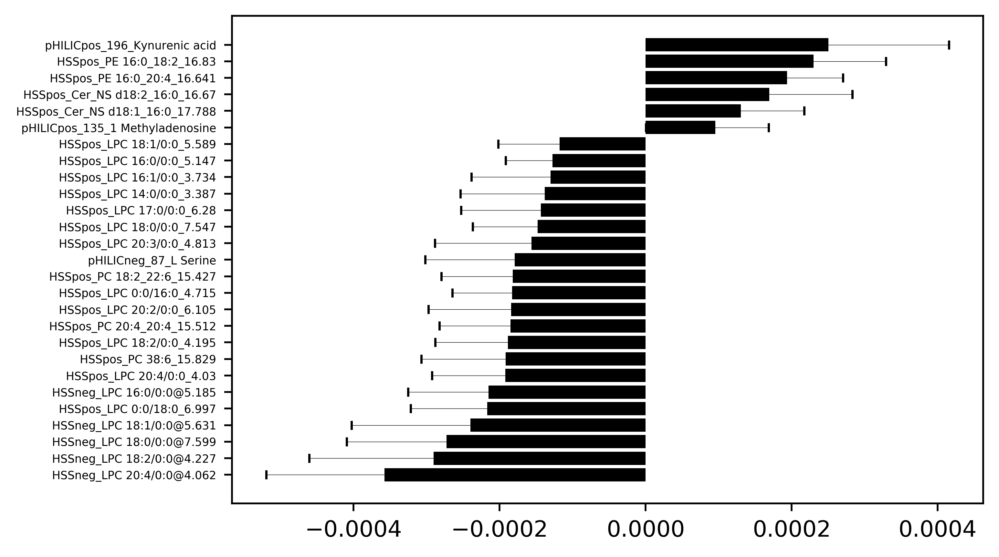

In [19]:
#filter out feats passing zero

goodMets = []
for x in range(len(coefs)):
    if coefs_ci[x][0] * coefs_ci[x][1] > 0:
        goodMets.append(x)
    if "Kynurenic" in  mol_names[order[x]]:
        print(mol_names[order[x]],coefs_ci[x][0],coefs_ci[x][1])
            
        
mol_names_sorted = mol_names[order]

plt.barh(range(len(goodMets)),width = var_imp[goodMets],xerr=[coefs_ci_normed[goodMets,0],coefs_ci_normed[goodMets,1]],ecolor="black",capsize=2,error_kw={"elinewidth":0.2,"barsabove":False},color="black")

plt.yticks(range(len(goodMets)),mol_names_sorted[goodMets],fontsize=5)
print(len(goodMets))

In [20]:
#output sig mets
goodMetDict = {}
for x in goodMets:
    print(mol_names_sorted[x])
    goodMetDict[mol_names_sorted[x]] = {"var_imp":var_imp[x],"lb":coefs_ci_normed[x,0],"ub":coefs_ci_normed[x,1]}


HSSneg_LPC 20:4/0:0@4.062
HSSneg_LPC 18:2/0:0@4.227
HSSneg_LPC 18:0/0:0@7.599
HSSneg_LPC 18:1/0:0@5.631
HSSpos_LPC 0:0/18:0_6.997
HSSneg_LPC 16:0/0:0@5.185
HSSpos_LPC 20:4/0:0_4.03
HSSpos_PC 38:6_15.829
HSSpos_LPC 18:2/0:0_4.195
HSSpos_PC 20:4_20:4_15.512
HSSpos_LPC 20:2/0:0_6.105
HSSpos_LPC 0:0/16:0_4.715
HSSpos_PC 18:2_22:6_15.427
pHILICneg_87_L Serine
HSSpos_LPC 20:3/0:0_4.813
HSSpos_LPC 18:0/0:0_7.547
HSSpos_LPC 17:0/0:0_6.28
HSSpos_LPC 14:0/0:0_3.387
HSSpos_LPC 16:1/0:0_3.734
HSSpos_LPC 16:0/0:0_5.147
HSSpos_LPC 18:1/0:0_5.589
pHILICpos_135_1 Methyladenosine
HSSpos_Cer_NS d18:1_16:0_17.788
HSSpos_Cer_NS d18:2_16:0_16.67
HSSpos_PE 16:0_20:4_16.641
HSSpos_PE 16:0_18:2_16.83
pHILICpos_196_Kynurenic acid


In [21]:
#remove redundancies

goodMets = [goodMets[x] for x in range(len(goodMets)) if x not in [0,1,2,3,5]]


In [22]:
#use confirm samples with signfiicant mets

k=len(X_train)
n=20

model_parameter_lists = [{"feat_selection":feat_params,"C":[0.001,0.01,.1,1,10,100],"l1_ratio":np.linspace(0,1,10)},
                         {"feat_selection":feat_params,"alpha":[0.001,0.01,.1,1,10,100],"l1_ratio":np.linspace(0,1,10)},
                         {"feat_selection":feat_params,"n_components":range(1,10)},
                         {"feat_selection":feat_params,"C":[1e-3,1e-2,1e-1,1,10,100],"kernel":["linear","poly","rbf","sigmoid"]},
                         {"feat_selection":feat_params,"max_features":["auto","log2",None],"max_depth":[None,1,5,10,20,50],"n_estimators": [int(x) for x in np.linspace(1,200,5)]}]


paramsToTry = model_parameter_lists[model_names.index(model)]


paramsToTry["feat_selection"] = [("corr",1.0)]

print(paramsToTry)

order = np.array(order)



_,err_cv,mod_params,log_pred = helper.optimizeHyperParams(paramsToTry,X_train[:,order[goodMets]],y_train,X_blank[:,order[goodMets]],np.array(mol_names_sorted)[goodMets],trainFunc,predictFunc,k=k,n=n)

print(err_cv,mod_params)
#mod_params = dict(params)
#mod_params["feat_selection"] = ("corr",1.0)



obj = trainFunc(X_train[:,order[goodMets]],y_train,X_blank[:,order[goodMets]],np.array(mol_names_sorted)[goodMets],mod_params)
y_pred_confirm = predictFunc(obj,X_test[:,order[goodMets]])
confirm_score = helper.score(y_pred_confirm,y_test)
print("training (b1-6): ",helper.score(predictFunc(obj,X_train[:,order[goodMets]]),y_train))
print("test (b7-9):",confirm_score )


numPerm = 1000 #change to 10,000
res = []
fprs_tprs = []
for _ in range(numPerm):
    order_t = list(range(len(y_train)))
    rd.shuffle(order_t)
    y_shuff = np.array([y_train[x] for x in order_t])
    obj = trainFunc(X_train[:,order[goodMets]], y_shuff, X_train_blank[:,order[goodMets]], np.array(mol_names_sorted)[goodMets], mod_params)
    y_pred = predictFunc(obj,X_test[:,order[goodMets]])
    err_shuff = helper.score(y_pred,y_test)
    res.append(err_shuff)
    fpr,tpr,_ = sklearn.metrics.roc_curve(y_test,y_pred)
    fprs_tprs.append([fpr,tpr])
    


{'feat_selection': [('corr', 1.0)], 'alpha': [0.001, 0.01, 0.1, 1, 10, 100], 'l1_ratio': array([0.        , 0.11111111, 0.22222222, 0.33333333, 0.44444444,
       0.55555556, 0.66666667, 0.77777778, 0.88888889, 1.        ])}
0.7971385542168674 {'feat_selection': ('corr', 1.0), 'alpha': 1, 'l1_ratio': 0.0}
training (b1-6):  0.8233433734939758
test (b7-9): 0.6966666666666665


112 59 68 27
(112, 31)
0.7743055555555556 0.6631944444444444 0.6990740740740741
CRP 0.732638888888889
D-dimer 0.7303240740740741
Neutrophil absolute 0.7326388888888891
Lymphocyte absolute 0.7158564814814815
Diabetes 0.5248842592592593
Chronic kidney disease 0.47048611111111116
Cancer 0.4930555555555556
BMI 0.5121527777777778
Age 0.5601851851851852


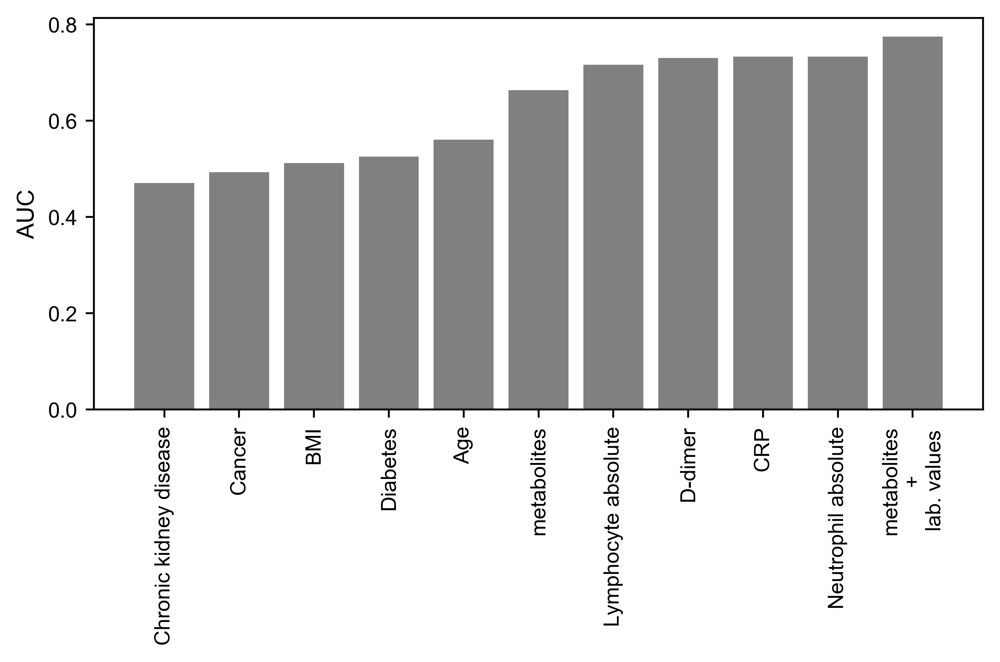

In [23]:
outdict = {}
ind += 1
for col in measurement_data.columns.values:
    clinical = []
    tmp = [r[col] for r in X_test_measurement]
    trues = []
    preds = []
    for comorb,true,pred in zip(tmp,y_test,y_pred_confirm):
        if not pd.isna(comorb):
            if type(comorb) == type(""):
                comorb = comorb.replace("<","").replace(">","")
            if float(comorb) > -.5:
                clinical.append(float(comorb))
                trues.append(true)
                preds.append(pred)
    #fpr,tpr,thresolds = sklearn.metrics.roc_curve(trues,clinical)
    #plt.plot(fpr,tpr,c="red",label=col)
    #plt.scatter(fpr,tpr,c="red")
    #fpr,tpr,thresolds = sklearn.metrics.roc_curve(trues,preds)
    #plt.plot(fpr,tpr,c="blue",label = "Model")
    #plt.scatter(fpr,tpr,c="blue")
    #plt.xlabel("fpr")
    #plt.ylabel("tpr")
    #plt.ylim((0,1.1))
    #plt.plot([0,1],[0,1])
    #plt.title(col)
    #plt.figure()
    if len(preds) > 0:
        score = helper.score(clinical,trues)
        scoreRev = helper.score(np.array(clinical) * -1,trues)
        score = max([score,scoreRev])

        scoreModel = helper.score(preds,trues)
        outdict[ind] = {"value":col,"auc_val":score,"auc_model":scoreModel,"relative_auc":score/scoreModel,"n":len(trues)}
        ind += 1
        
clinicalPreds = ["CRP","D-dimer","Neutrophil %","Diabetes","Chronic kidney disease","Cancer","BMI","Age","Neutrophil absolute","Lymphocyte absolute","Lymphocyte %"]
clinicalPreds = ["CRP","D-dimer","Neutrophil absolute","Lymphocyte absolute","Diabetes","CO2","High/Low arterial pH","Chronic kidney disease","Cancer","BMI","Age"]
clinicalPreds = ["CRP","D-dimer","Neutrophil absolute","Lymphocyte absolute","Diabetes","Chronic kidney disease","Cancer","BMI","Age"]

toLog = ["CRP","D-dimer"]
#toLog = []
X_clin_train = []
y_clin_train = []
X_clin_test = []
y_clin_test = []
y_model_pred = []

for true,pred,i in zip(y_test,y_pred_confirm,range(len(y_test))):
    inAll = True
    mets = X_test[i,order[goodMets]]
    clinical = []
    tmp = [X_test_measurement[i][col] for col in clinicalPreds]
    for comorb,t in zip(tmp,clinicalPreds):
        good = False
        if not pd.isna(comorb):
            if type(comorb) == type(""):
                comorb = comorb.replace("<","").replace(">","")
            if float(comorb) > -.5:
                good = True
        if good:
            if t in toLog:
                clinical.append(np.log2(float(comorb)))
            else:
                clinical.append(float(comorb))
        else:
            inAll = False
        
            

    if inAll:
        X_clin_test.append(list(mets) + clinical)
        y_clin_test.append(true)
        y_model_pred.append(pred)
        
for true,i in zip(y_train,range(len(y_train))):
    inAll = True
    mets = X_train[i,order[goodMets]]
    clinical = []
    tmp = [X_train_measurement[i][col] for col in clinicalPreds]
    for comorb,t in zip(tmp,clinicalPreds):
        good = False
        if not pd.isna(comorb):
            if type(comorb) == type(""):
                comorb = comorb.replace("<","").replace(">","")
            if float(comorb) > -.5:
                good = True
        if good:
            if t in toLog:
                clinical.append(np.log2(float(comorb)))
            else:
                clinical.append(float(comorb))
        else:
            inAll = False
        
            

    if inAll:
        X_clin_train.append(list(mets) + clinical)
        y_clin_train.append(true)

print(len(y_clin_train),len(y_clin_test),np.sum(y_clin_train),np.sum(y_clin_test))

X_clin_train = np.array(X_clin_train)
X_clin_test = np.array(X_clin_test)
y_clin_train = np.array(y_clin_train)
y_clin_test = np.array(y_clin_test)

print(X_clin_train.shape)

_,err_cv,tmp_params,_ = helper.optimizeHyperParams(paramsToTry,X_clin_train[:,:len(goodMets) + 4],y_clin_train,X_blank[:,order[goodMets]],np.array(mol_names_sorted)[goodMets],trainFunc,predictFunc,k=k,n=n)
obj = trainFunc(X_clin_train[:,:len(goodMets) + 4],y_clin_train,X_blank[:,order[goodMets]],np.array(mol_names_sorted)[goodMets],mod_params)
y_pred_all = predictFunc(obj,X_clin_test[:,:len(goodMets) + 4])
score_all = helper.score(y_pred_all,y_clin_test)
score_model = helper.score(y_model_pred,y_clin_test)

#_,err_cv,tmp_params,_ = helper.optimizeHyperParams(paramsToTry,X_clin_train[:,len(goodMets):],y_clin_train,X_blank[:,order[goodMets]],np.array(mol_names_sorted)[goodMets],trainFunc,predictFunc,k=k,n=n)
obj = trainFunc(X_clin_train[:,len(goodMets):],y_clin_train,X_blank[:,order[goodMets]],np.array(mol_names_sorted)[goodMets],mod_params)
y_pred_all = predictFunc(obj,X_clin_test[:,len(goodMets):])
score_clin = helper.score(y_pred_all,y_clin_test)
print(score_all,score_model,score_clin)

labels = ["metabolites\n+\nlab. values","metabolites","clinical"]
scores = [score_all,score_model,score_clin]

labels = ["metabolites\n+\nlab. values","metabolites"]
scores = [score_all,score_model]

for x in range(len(clinicalPreds)):
    tmp = X_clin_test[:,len(goodMets) + x]
    obj = trainFunc(X_clin_train[:,len(goodMets)+x:len(goodMets)+x+1],y_clin_train,X_blank[:,order[goodMets]],np.array(mol_names_sorted)[goodMets],mod_params)
    tmp = predictFunc(obj,X_clin_test[:,len(goodMets)+x:len(goodMets)+x+1])
    s = helper.score(tmp,y_clin_test)
    #s_m = helper.score(tmp*-1,y_clin_test)
    #if s_m > s:
    #    s = s_m
    labels.append(clinicalPreds[x])
    scores.append(s)
    print(clinicalPreds[x],s)
    
ordering = list(range(len(labels)))
ordering.sort(key=lambda x: scores[x])
labels = [labels[x] for x in ordering]
scores = [scores[x] for x in ordering]

plt.bar(range(len(labels)),scores,tick_label=labels,color="grey")
plt.xticks(fontsize=9,rotation=90,fontfamily="Arial")
plt.ylabel("AUC",fontfamily="Arial")
plt.yticks(fontsize=9,fontfamily="Arial")
plt.tight_layout()
plt.savefig("../manuscript_figs/clinical_predictive_vs_model.png")

pd.DataFrame.from_dict(outdict,orient="index").to_csv("clinical_v_model_reduced.csv",index=False)

In [24]:
paramsToTry

{'feat_selection': [('corr', 1.0)],
 'alpha': [0.001, 0.01, 0.1, 1, 10, 100],
 'l1_ratio': array([0.        , 0.11111111, 0.22222222, 0.33333333, 0.44444444,
        0.55555556, 0.66666667, 0.77777778, 0.88888889, 1.        ])}

11
prediction model acc.  0.63
baseline model acc.  0.59
baseline auc 0.5966666666666667


Text(0.5, 0, '')

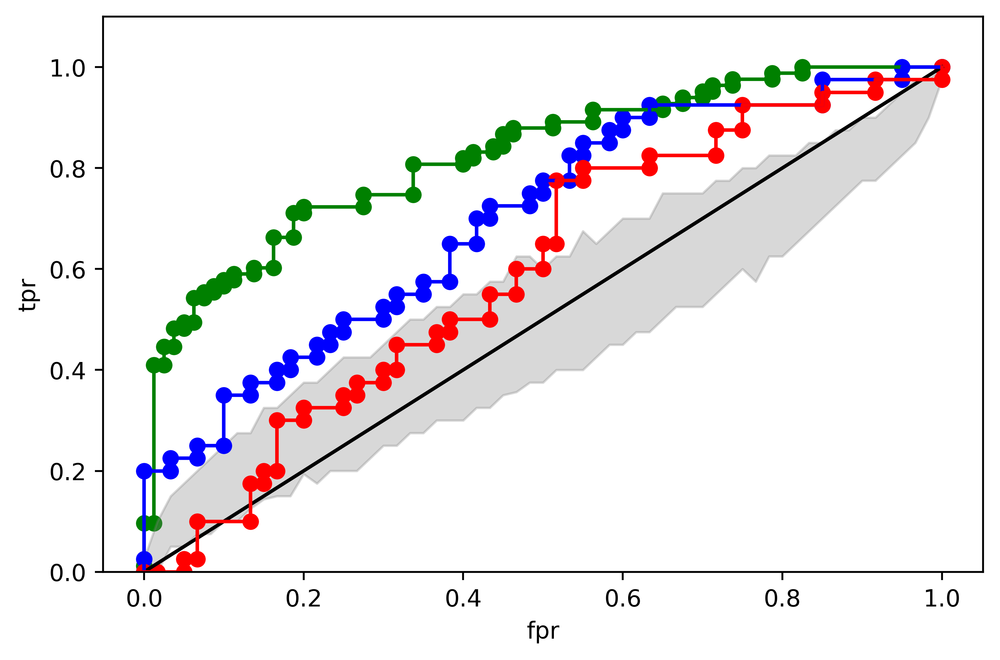

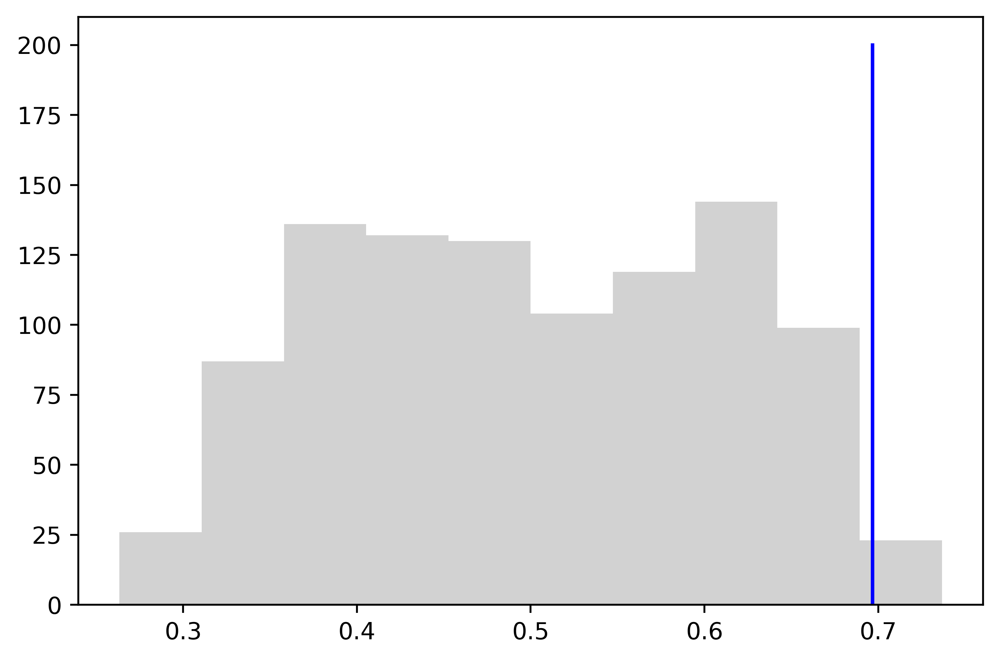

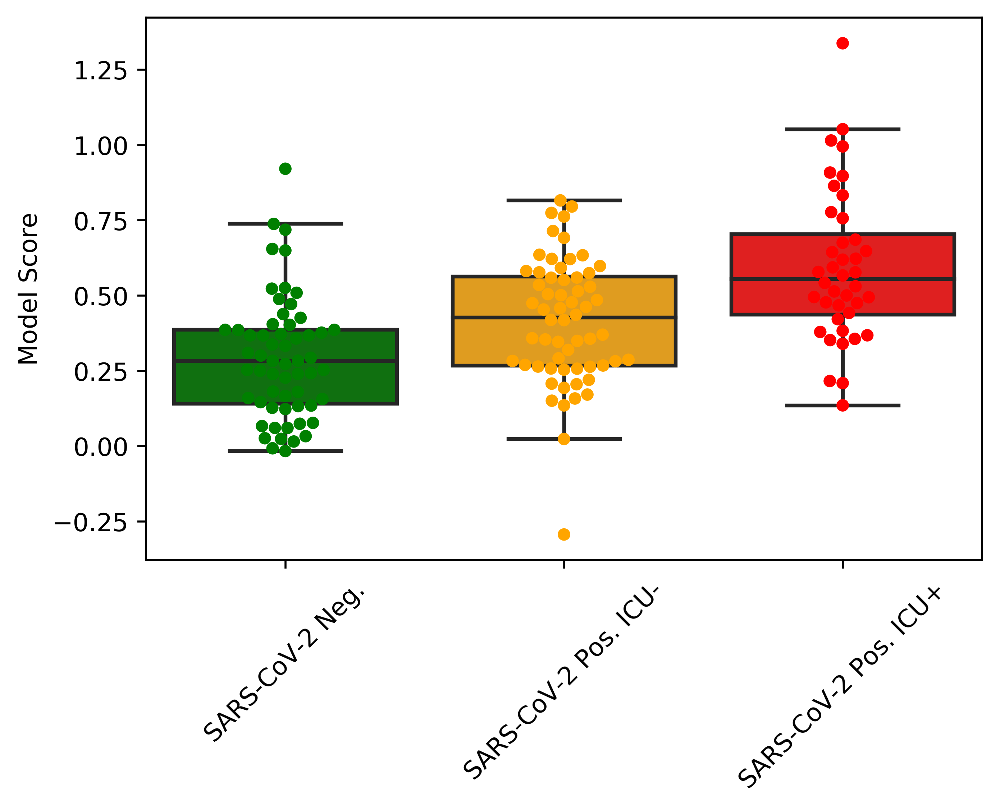

In [25]:
   
obj = trainFunc(X_train[:,order[goodMets]],y_train,X_blank[:,order[goodMets]],np.array(mol_names_sorted)[goodMets],mod_params)

    
# fpr,tpr,thresolds = sklearn.metrics.roc_curve(y,y_train_whole)
# plt.plot(fpr,tpr)
# plt.scatter(fpr,tpr)
plt.xlabel("fpr")
plt.ylabel("tpr")
plt.ylim((0,1.1))
plt.plot([0,1],[0,1],color="black")

fpr,tpr,thresolds = sklearn.metrics.roc_curve(y_train,predictFunc(obj,X_train[:,order[goodMets]]))
plt.plot(fpr,tpr,color="green")
plt.scatter(fpr,tpr,color="green")
    


fprs = np.array([])
for fpr,tpr in fprs_tprs:
    fprs = np.concatenate((fprs,fpr))
fprs = list(set(fprs))    
matched_vals = {fpr:[] for fpr in fprs}

for fpr,tpr in fprs_tprs:
    for f,t in zip(fpr,tpr):
        matched_vals[f].append(t)

matched_vals = {f:[np.percentile(val,25),np.percentile(val,75)] for f,val in matched_vals.items()}
fpr_rand = list(matched_vals.keys())
fpr_rand.sort()
tpr_min = [matched_vals[f][0] for f in fpr_rand]
tpr_max = [matched_vals[f][1] for f in fpr_rand]

plt.fill_between(fpr_rand,tpr_min,tpr_max,facecolor="grey",color="grey",alpha=.3)

y_pred_confirm_all = predictFunc(obj,X_test[:,order[goodMets]])

err_test = helper.score(y_pred_confirm_all,y_test)

print(len([x for x in res if x > err_test]))

fpr,tpr,thresolds = sklearn.metrics.roc_curve(y_test,y_pred_confirm_all)
plt.plot(fpr,tpr,color="blue")
plt.scatter(fpr,tpr,color="blue")

logistic_reg = sklearn.linear_model.LogisticRegression(penalty="none")
logistic_reg.fit([[x] for x in predictFunc(obj,X_train[:,order[goodMets]])],y_train)

print("prediction model acc. ",logistic_reg.score([[x] for x in y_pred_confirm_all],y_test))


age_train = X_train_age
bmi_train = X_train_bmi
baseline_train = np.array([age_train,bmi_train]).transpose()

baseline_test = np.array([X_test_age,X_test_bmi]).transpose()

log_reg = sklearn.linear_model.LinearRegression(fit_intercept=True)

log_reg.fit(baseline_train,np.array(y_train_baseline))
pred_baseline = log_reg.predict(baseline_test)


logistic_reg.fit([[x] for x in log_reg.predict(baseline_train)],y_train_baseline)

print("baseline model acc. ",logistic_reg.score([[x] for x in pred_baseline],y_test_baseline))

fpr,tpr,thresolds = sklearn.metrics.roc_curve(y_test_baseline,pred_baseline)
plt.plot(fpr,tpr,color="red")
plt.scatter(fpr,tpr,color="red")

print("baseline auc",helper.score(pred_baseline,y_test_baseline))

plt.tight_layout()
plt.savefig("../manuscript_figs/reduced_model_roc.png")
    
#plot histogram
plt.figure()
plt.hist(res,color="grey",alpha=.35)
plt.plot([confirm_score,confirm_score],[0,.2*numPerm],color="blue")

y_val_pred = predictFunc(obj,X_val[:,order[goodMets]])
y_neg_pred = [y_pred_confirm_all[x] for x in range(len(y_test)) if y_test[x] < .5]
y_pos_pred = [y_pred_confirm_all[x] for x in range(len(y_test)) if y_test[x] > .5]

plt.tight_layout()
plt.savefig("../manuscript_figs/reduced_model_permutation_hist.png")

plt.figure()
plot_df = {}
ind = 0
for x in y_val_pred:
    plot_df[ind] = {"Status":"SARS-CoV-2 Neg.","Model Score":x}
    ind += 1

for x in y_neg_pred:
    plot_df[ind] = {"Status":"SARS-CoV-2 Pos. ICU-","Model Score":x}
    ind += 1

for x in y_pos_pred:
    plot_df[ind] = {"Status":"SARS-CoV-2 Pos. ICU+","Model Score":x}
    ind += 1

plot_df = pd.DataFrame.from_dict(plot_df,orient="index")
sb.boxplot(data=plot_df,x="Status",y="Model Score",fliersize=0,palette={"SARS-CoV-2 Neg.":"green",
                                                                        "SARS-CoV-2 Pos. ICU-":"orange",
                                                                        "SARS-CoV-2 Pos. ICU+":"red"})

sb.swarmplot(data=plot_df,x="Status",y="Model Score",palette={"SARS-CoV-2 Neg.":"green",
                                                                        "SARS-CoV-2 Pos. ICU-":"orange",
                                                                        "SARS-CoV-2 Pos. ICU+":"red"},dodge=True)
plt.xticks(rotation=45)
plt.xlabel("")


1.0
2.0
4.0
1.0
2.0
11.0
1.0
training dist 13 93
115
(67, 22)
[0.     0.0125 0.0125 0.0625 0.0625 0.1875 0.1875 0.2    0.2    0.275
 0.275  0.4375 0.4375 0.45   0.45   0.5625 0.5625 0.7125 0.7125 1.    ] [0.         0.         0.30769231 0.30769231 0.38461538 0.38461538
 0.53846154 0.53846154 0.61538462 0.61538462 0.69230769 0.69230769
 0.76923077 0.76923077 0.84615385 0.84615385 0.92307692 0.92307692
 1.         1.        ]
7 67
0.7142857142857142
num random more:  49
baseline model acc.  0.59
baseline auc 0.5966666666666667
COV-:  59
COV+ non-severe:  140
COV+ severe:  20
HSSpos_LPC 0:0/18:0_6.997 1.6401123635783426e-05
HSSpos_LPC 20:4/0:0_4.03 0.001979818358852364
HSSpos_PC 38:6_15.829 1.0360855229692963e-08
HSSpos_LPC 18:2/0:0_4.195 6.496909580524715e-07
HSSpos_PC 20:4_20:4_15.512 3.4966471642977756e-07
HSSpos_LPC 20:2/0:0_6.105 5.792893140170274e-09
HSSpos_LPC 0:0/16:0_4.715 2.1536051789005913e-05
HSSpos_PC 18:2_22:6_15.427 3.542895451095005e-07
pHILICneg_87_L Serine 0.00761093770

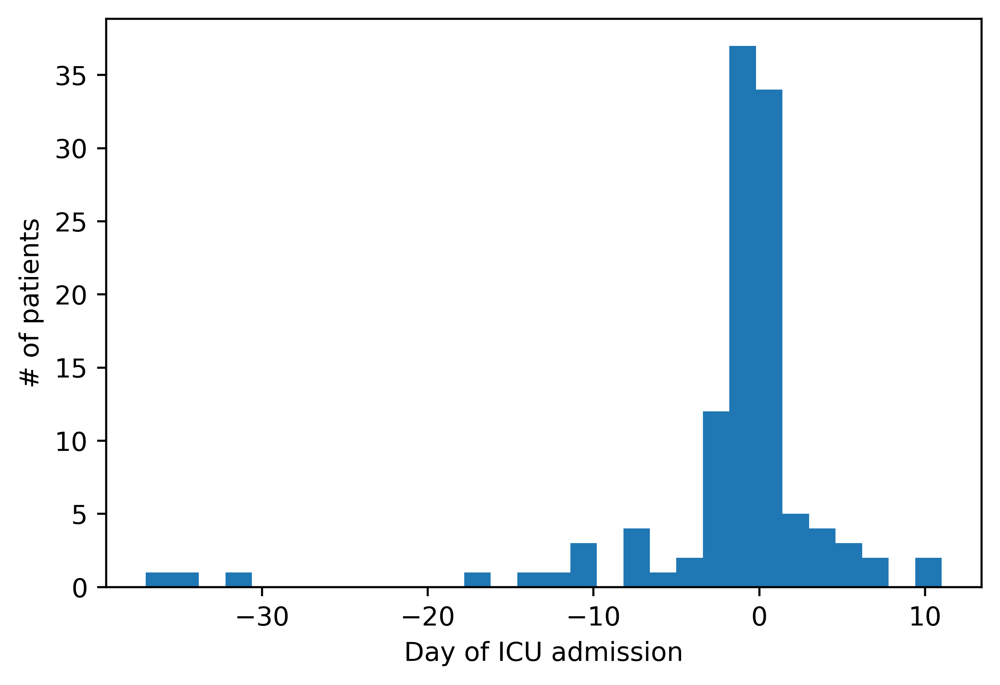

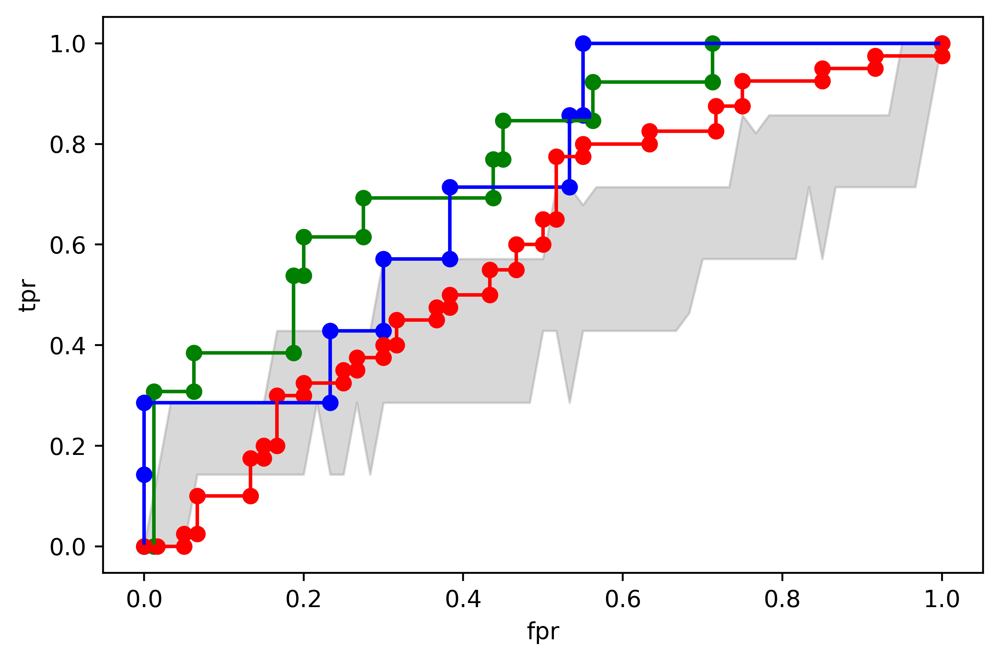

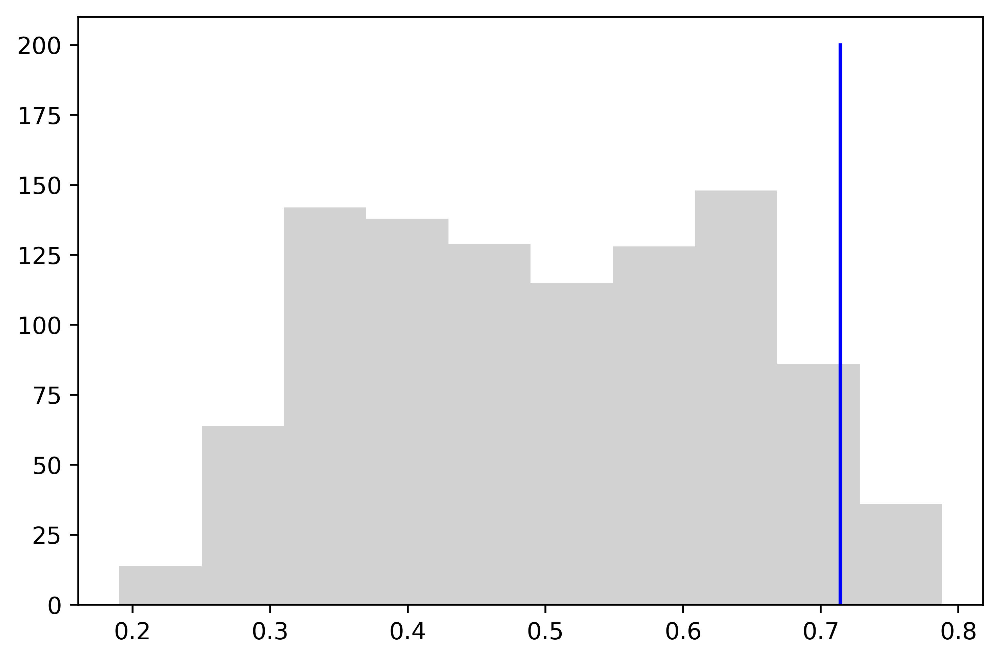

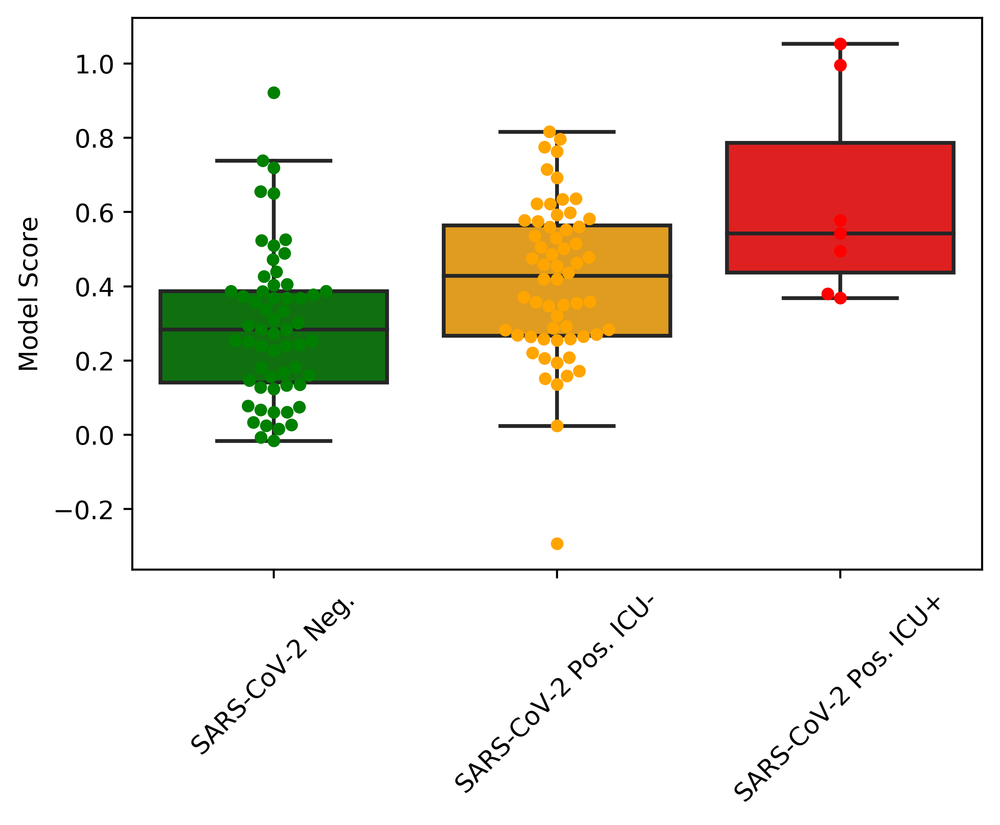

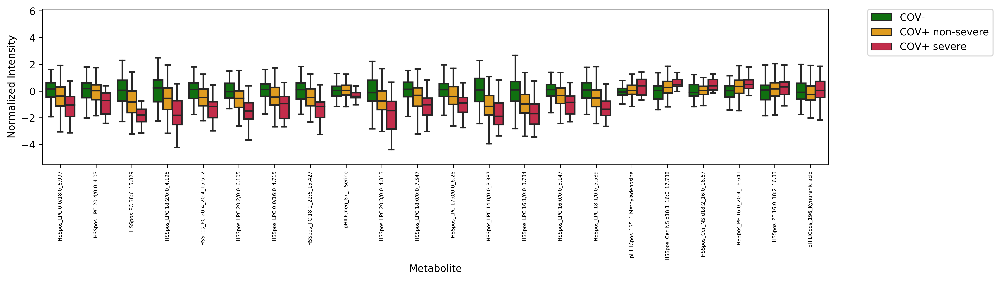

In [26]:
   

    
# fpr,tpr,thresolds = sklearn.metrics.roc_curve(y,y_train_whole)
# plt.plot(fpr,tpr)
# plt.scatter(fpr,tpr)
#plt.xlabel("fpr")
#plt.ylabel("tpr")
#plt.ylim((0,1.1))
#plt.plot([0,1],[0,1],color="black")


    




non_icu_imm = []
when_icu = []
non_icu_imm_train = []
for x,i in zip(X_test_metadata,range(len(X_test_metadata))):
    try:
        if y_test[i] < .5:
            non_icu_imm.append(i)
            
        float(x["WU350-Symptom onset"])
        float(x["Epic: Time from symptom onset to ICU (days)"])
        if (y_test[i] > .5): when_icu.append(float(x["Epic: Time from symptom onset to ICU (days)"]) - float(x["WU350-Symptom onset"]))
        if y_test[i] > .5 and float(x["Epic: Time from symptom onset to ICU (days)"]) - float(x["WU350-Symptom onset"]) > 0:
            #print(float(x["Epic: Time from symptom onset to ICU (days)"]),float(x["WU350-Symptom onset"]))
            non_icu_imm.append(i)
            print(float(x["Epic: Time from symptom onset to ICU (days)"]) - float(x["WU350-Symptom onset"]))
                
    except:
        pass
    
for x,i in zip(X_train_metadata,range(len(X_train_metadata))):
    try:
        if y_train[i] < .5:
            non_icu_imm_train.append(i)
        float(x["WU350-Symptom onset"])
        float(x["Epic: Time from symptom onset to ICU (days)"])
        if y_train[i] > .5:
            when_icu.append(float(x["Epic: Time from symptom onset to ICU (days)"]) - float(x["WU350-Symptom onset"]))
            if float(x["Epic: Time from symptom onset to ICU (days)"]) - float(x["WU350-Symptom onset"]) > 0:
                non_icu_imm_train.append(i)

    except:
        pass
print("training dist",np.sum(y_train[non_icu_imm_train]),len(non_icu_imm_train))
print(len(when_icu))
plt.hist(when_icu,bins=30)
plt.xlabel("Day of ICU admission")
plt.ylabel("# of patients")
plt.figure()

numPerm = 1000 #change to 10,000
res = []
fprs_tprs = []
for _ in range(numPerm):
    order_t = list(range(len(y_train)))
    rd.shuffle(order_t)
    y_shuff = np.array([y_train[x] for x in order_t])
    obj = trainFunc(X_train[:,order[goodMets]], y_shuff, X_train_blank[:,order[goodMets]], np.array(mol_names_sorted)[goodMets], mod_params)
    y_pred = predictFunc(obj,X_test[:,order[goodMets]][non_icu_imm,:])
    err_shuff = helper.score(y_pred,y_test[non_icu_imm])
    res.append(err_shuff)
    fpr,tpr,_ = sklearn.metrics.roc_curve(y_test[non_icu_imm],y_pred)
    fprs_tprs.append([fpr,tpr])

fprs = np.array([])
for fpr,tpr in fprs_tprs:
    fprs = np.concatenate((fprs,fpr))
fprs = list(set(fprs))    
matched_vals = {fpr:[] for fpr in fprs}

for fpr,tpr in fprs_tprs:
    for f,t in zip(fpr,tpr):
        matched_vals[f].append(t)

matched_vals = {f:[np.percentile(val,25),np.percentile(val,75)] for f,val in matched_vals.items()}
fpr_rand = list(matched_vals.keys())
fpr_rand.sort()
tpr_min = [matched_vals[f][0] for f in fpr_rand]
tpr_max = [matched_vals[f][1] for f in fpr_rand]

plt.fill_between(fpr_rand,tpr_min,tpr_max,facecolor="grey",color="grey",alpha=.3)

print(X_test[:,order[goodMets]][non_icu_imm,:].shape)

obj = trainFunc(X_train[:,order[goodMets]],y_train,X_blank[:,order[goodMets]],np.array(mol_names_sorted)[goodMets],mod_params)

fpr,tpr,thresolds = sklearn.metrics.roc_curve(y_train[non_icu_imm_train],predictFunc(obj,X_train[:,order[goodMets]][non_icu_imm_train]))
print(fpr,tpr)
plt.plot(fpr,tpr,color="green")
plt.scatter(fpr,tpr,color="green")

y_pred_confirm_all = predictFunc(obj,X_test[:,order[goodMets]][non_icu_imm,:])

err_test = helper.score(y_pred_confirm_all,y_test[non_icu_imm])
print(np.sum(y_test[non_icu_imm]),len(y_test[non_icu_imm]))

print(err_test)

print("num random more: ",len([x for x in res if x > err_test]))



fpr,tpr,thresolds = sklearn.metrics.roc_curve(y_test[non_icu_imm],y_pred_confirm_all)
plt.plot(fpr,tpr,color="blue")
plt.scatter(fpr,tpr,color="blue")

plt.xlabel("fpr")
plt.ylabel("tpr")
age_train = X_train_age
bmi_train = X_train_bmi
baseline_train = np.array([age_train,bmi_train]).transpose()

baseline_test = np.array([X_test_age,X_test_bmi]).transpose()

log_reg = sklearn.linear_model.LinearRegression(fit_intercept=True)

log_reg.fit(baseline_train,np.array(y_train_baseline))
pred_baseline = log_reg.predict(baseline_test)


logistic_reg.fit([[x] for x in log_reg.predict(baseline_train)],y_train_baseline)

print("baseline model acc. ",logistic_reg.score([[x] for x in pred_baseline],y_test_baseline))

fpr,tpr,thresolds = sklearn.metrics.roc_curve(y_test_baseline,pred_baseline)
plt.plot(fpr,tpr,color="red")
plt.scatter(fpr,tpr,color="red")

plt.tight_layout()
plt.savefig("../manuscript_figs/reduced_model_roc_future_pat.png")

#plot histogram
plt.figure()
plt.hist(res,color="grey",alpha=.35)
plt.plot([err_test,err_test],[0,.2*numPerm],color="blue")


print("baseline auc",helper.score(pred_baseline,y_test_baseline))

y_val_pred = predictFunc(obj,X_val[:,order[goodMets]])
y_neg_pred = [y_pred_confirm_all[x] for x in range(len(y_test[non_icu_imm])) if y_test[non_icu_imm][x] < .5]
y_pos_pred = [y_pred_confirm_all[x] for x in range(len(y_test[non_icu_imm])) if y_test[non_icu_imm][x] > .5]

plt.tight_layout()
plt.savefig("../manuscript_figs/reduced_model_permutation_hist_future_pat.png")

plt.figure()
plot_df = {}
ind = 0
for x in y_val_pred:
    plot_df[ind] = {"Status":"SARS-CoV-2 Neg.","Model Score":x}
    ind += 1

for x in y_neg_pred:
    plot_df[ind] = {"Status":"SARS-CoV-2 Pos. ICU-","Model Score":x}
    ind += 1

for x in y_pos_pred:
    plot_df[ind] = {"Status":"SARS-CoV-2 Pos. ICU+","Model Score":x}
    ind += 1

plot_df = pd.DataFrame.from_dict(plot_df,orient="index")
sb.boxplot(data=plot_df,x="Status",y="Model Score",fliersize=0,palette={"SARS-CoV-2 Neg.":"green",
                                                                        "SARS-CoV-2 Pos. ICU-":"orange",
                                                                        "SARS-CoV-2 Pos. ICU+":"red"})

sb.swarmplot(data=plot_df,x="Status",y="Model Score",palette={"SARS-CoV-2 Neg.":"green",
                                                                        "SARS-CoV-2 Pos. ICU-":"orange",
                                                                        "SARS-CoV-2 Pos. ICU+":"red"},dodge=True)
plt.xticks(rotation=45)
plt.xlabel("")


plots = []
pvals = []
names = []
ind = 0

tempDict = {}

mapper = {-1:"COV-",0:"COV+ non-severe",1:"COV+ severe"}
for met,i in zip(goodMets,range(len(goodMets))):
    norm = np.mean(X_val[:,order[met]])
    tempX = np.concatenate((X_train[non_icu_imm_train,order[met]],X_test[non_icu_imm,order[met]],X_val[:,order[met]])) - norm
    tempy = np.concatenate((y_train[non_icu_imm_train],y_test[non_icu_imm],[-1 for x in X_val]))
    
    for x,yy in zip(tempX,tempy):
        tempDict[ind] = {"group":mapper[yy],"Normalized Intensity":x,"Metabolite":mol_names_sorted[met]}
        ind += 1
    
    
print("COV-: ",len([x for x in tempy if x < -.5]))
print("COV+ non-severe: ",len([x for x in tempy if x > -.5 and x < .5]))
print("COV+ severe: ",len([x for x in tempy if x > .5]))

tempDf = pd.DataFrame.from_dict(tempDict,orient="index")


fig,ax = plt.subplots(figsize=(14,4))

# sb.swarmplot(data=tempDf,x="Metabolite",y="Normalized Intensity",hue="ICU",dodge=True,palette={mapper[-1]:"green",
#                                                                                  mapper[0]:"orange",
#                                                                                  mapper[1]:"crimson"},size=1.5)
sb.boxplot(data=tempDf,x="Metabolite",y="Normalized Intensity",hue="group",fliersize=0,palette={mapper[-1]:"green",
                                                                                 mapper[0]:"orange",
                                                                                 mapper[1]:"crimson"},
           hue_order=["COV-","COV+ non-severe","COV+ severe"])
plt.xticks(rotation=90,fontsize=5)

handles, labels = ax.get_legend_handles_labels()
l = plt.legend(handles[0:3], labels[0:3], bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    
plt.tight_layout()
plt.savefig("../manuscript_figs/reduced_model_future_patient_boxplot_individualMets.png")  

for met in goodMets:
    
    f,p = stats.f_oneway(*[tempDf[(tempDf["group"] == x) & (tempDf["Metabolite"] == mol_names_sorted[met])]["Normalized Intensity"].values for x in ["COV-","COV+ non-severe","COV+ severe"]])
    pvals.append(p)
    names.append(mol_names_sorted[met])
    
alpha = 0.05
reject,pvals_corr,_,_ = multipletests(pvals,alpha,method="fdr_bh")

for p,name in zip(pvals_corr,names):
    print(name,p)


155 65 80 7
(155, 24)
0.7832512315270936 0.7044334975369457 0.7857142857142857
Lymphocyte % 0.7413793103448276
Neutrophil % 0.8017241379310345


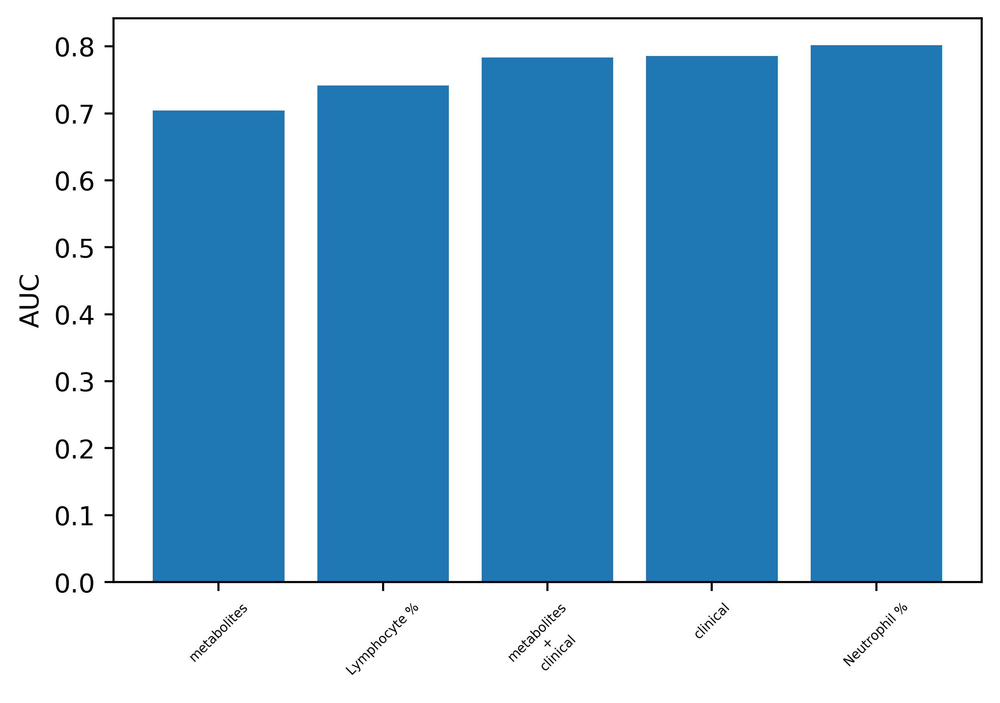

In [27]:
outdict = {}
ind += 1
for col in measurement_data.columns.values:
    clinical = []
    tmp = [r[col] for r in X_test_measurement]
    trues = []
    preds = []
    for comorb,true,pred in zip(tmp,y_test,y_pred_confirm):
        if not pd.isna(comorb):
            if type(comorb) == type(""):
                comorb = comorb.replace("<","").replace(">","")
            if float(comorb) > -.5:
                clinical.append(float(comorb))
                trues.append(true)
                preds.append(pred)
    #fpr,tpr,thresolds = sklearn.metrics.roc_curve(trues,clinical)
    #plt.plot(fpr,tpr,c="red",label=col)
    #plt.scatter(fpr,tpr,c="red")
    #fpr,tpr,thresolds = sklearn.metrics.roc_curve(trues,preds)
    #plt.plot(fpr,tpr,c="blue",label = "Model")
    #plt.scatter(fpr,tpr,c="blue")
    #plt.xlabel("fpr")
    #plt.ylabel("tpr")
    #plt.ylim((0,1.1))
    #plt.plot([0,1],[0,1])
    #plt.title(col)
    #plt.figure()
    if len(preds) > 0:
        score = helper.score(clinical,trues)
        scoreRev = helper.score(np.array(clinical) * -1,trues)
        score = max([score,scoreRev])

        scoreModel = helper.score(preds,trues)
        outdict[ind] = {"value":col,"auc_val":score,"auc_model":scoreModel,"relative_auc":score/scoreModel,"n":len(trues)}
        ind += 1
        
clinicalPreds = ["CRP","D-dimer","Neutrophil %","Diabetes","Chronic kidney disease","Cancer","BMI","Age","Neutrophil absolute","Lymphocyte absolute","Lymphocyte %"]
clinicalPreds = ["CRP","D-dimer","Neutrophil %","Diabetes","Chronic kidney disease","Cancer","BMI","Age","Lymphocyte %"]
clinicalPreds = ["Lymphocyte %","Neutrophil %"]

toLog = ["CRP","D-dimer"]
toLog = []
X_clin_train = []
y_clin_train = []
X_clin_test = []
y_clin_test = []
y_model_pred = []

for true,pred,i in zip(y_test,y_pred_confirm,range(len(y_test))):
    try:
        if y_test[i] < .5 or (y_test[i] > .5 and float(X_test_metadata[i]["Epic: Time from symptom onset to ICU (days)"]) - float(X_test_metadata[i]["WU350-Symptom onset"]) > 0):
            inAll = True
            mets = X_test[i,order[goodMets]]
            clinical = []
            tmp = [X_test_measurement[i][col] for col in clinicalPreds]
            for comorb,t in zip(tmp,clinicalPreds):
                good = False
                if not pd.isna(comorb):
                    if type(comorb) == type(""):
                        comorb = comorb.replace("<","").replace(">","")
                    if float(comorb) > -.5:
                        good = True
                if good:
                    if t in toLog:
                        clinical.append(np.log2(float(comorb)))
                    else:
                        clinical.append(float(comorb))
                else:
                    inAll = False



            if inAll:
                X_clin_test.append(list(mets) + clinical)
                y_clin_test.append(true)
                y_model_pred.append(pred)
    except:
        pass
        
for true,i in zip(y_train,range(len(y_train))):
    inAll = True
    mets = X_train[i,order[goodMets]]
    clinical = []
    tmp = [X_train_measurement[i][col] for col in clinicalPreds]
    for comorb,t in zip(tmp,clinicalPreds):
        good = False
        if not pd.isna(comorb):
            if type(comorb) == type(""):
                comorb = comorb.replace("<","").replace(">","")
            if float(comorb) > -.5:
                good = True
        if good:
            if t in toLog:
                clinical.append(np.log2(float(comorb)))
            else:
                clinical.append(float(comorb))
        else:
            inAll = False
        
            

    if inAll:
        X_clin_train.append(list(mets) + clinical)
        y_clin_train.append(true)

print(len(y_clin_train),len(y_clin_test),np.sum(y_clin_train),np.sum(y_clin_test))

X_clin_train = np.array(X_clin_train)
X_clin_test = np.array(X_clin_test)
y_clin_train = np.array(y_clin_train)
y_clin_test = np.array(y_clin_test)

print(X_clin_train.shape)

#_,err_cv,tmp_params,_ = helper.optimizeHyperParams(paramsToTry,X_clin_train,y_clin_train,X_blank[:,order[goodMets]],np.array(mol_names_sorted)[goodMets],trainFunc,predictFunc,k=k,n=n)
obj = trainFunc(X_clin_train,y_clin_train,X_blank[:,order[goodMets]],np.array(mol_names_sorted)[goodMets],mod_params)
y_pred_all = predictFunc(obj,X_clin_test)
score_all = helper.score(y_pred_all,y_clin_test)
score_model = helper.score(y_model_pred,y_clin_test)

#_,err_cv,tmp_params,_ = helper.optimizeHyperParams(paramsToTry,X_clin_train[:,len(goodMets):],y_clin_train,X_blank[:,order[goodMets]],np.array(mol_names_sorted)[goodMets],trainFunc,predictFunc,k=k,n=n)
obj = trainFunc(X_clin_train[:,len(goodMets):],y_clin_train,X_blank[:,order[goodMets]],np.array(mol_names_sorted)[goodMets],mod_params)
y_pred_all = predictFunc(obj,X_clin_test[:,len(goodMets):])
score_clin = helper.score(y_pred_all,y_clin_test)
print(score_all,score_model,score_clin)

labels = ["metabolites\n+\nclinical","metabolites","clinical"]
scores = [score_all,score_model,score_clin]
for x in range(len(clinicalPreds)):
    tmp = X_clin_test[:,len(goodMets) + x]
    obj = trainFunc(X_clin_train[:,len(goodMets)+x:len(goodMets)+x+1],y_clin_train,X_blank[:,order[goodMets]],np.array(mol_names_sorted)[goodMets],mod_params)
    tmp = predictFunc(obj,X_clin_test[:,len(goodMets)+x:len(goodMets)+x+1])
    s = helper.score(tmp,y_clin_test)
    #s_m = helper.score(tmp*-1,y_clin_test)
    #if s_m > s:
    #    s = s_m
    labels.append(clinicalPreds[x])
    scores.append(s)
    print(clinicalPreds[x],s)
    
ordering = list(range(len(labels)))
ordering.sort(key=lambda x: scores[x])
labels = [labels[x] for x in ordering]
scores = [scores[x] for x in ordering]

plt.bar(range(len(labels)),scores,tick_label=labels)
plt.xticks(fontsize=5,rotation=45)
plt.ylabel("AUC")

pd.DataFrame.from_dict(outdict,orient="index").to_csv("clinical_v_model_reduced.csv",index=False)

22


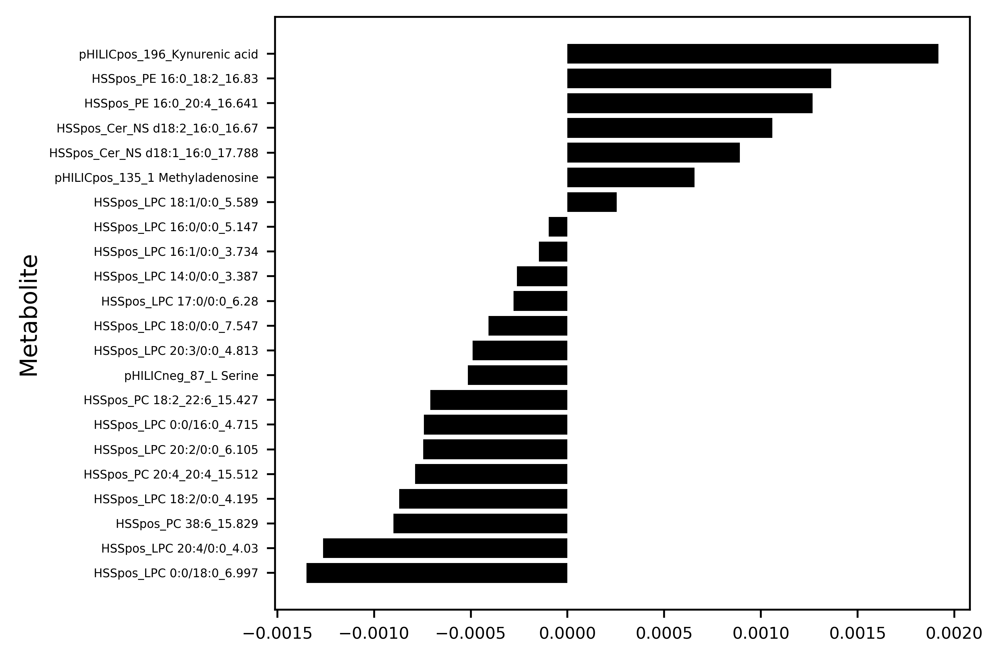

In [28]:
X_tot = np.concatenate((X_train[:,order[goodMets]],X_test[:,order[goodMets]]),axis=0)
y_tot = np.concatenate((y_train,y_test))
obj = trainFunc(X_tot,y_tot,
                X_blank[:,order[goodMets]],np.array(mol_names_sorted)[goodMets],mod_params)

var_imp_new = np.zeros((len(goodMets)))
var_imp_new[obj._selectedvars] = np.array(flatten(obj.coef_.tolist()))
var_imp_new = np.array([var_imp_new[x]/np.median(X_tot[:,x]) for x in range(len(var_imp_new))])

rel = var_imp_new[obj._selectedvars]
print(len([x for x in rel if np.abs(x) > 0]))
names =np.array(mol_names_sorted)[goodMets][obj._selectedvars]
o = list(range(len(rel)))
o.sort(key=lambda x:rel[x])
rel = rel[o]
names = names[o]
plt.barh(range(len(rel)),width = rel,color="black")
plt.yticks(range(len(goodMets)),mol_names_sorted[goodMets],fontsize=5)
#plt.xlabel("Normalized coef.")
plt.ylabel("Metabolite")
plt.xticks(fontsize=7)
plt.tight_layout()
plt.savefig("../manuscript_figs/variable_importance_reduced.png")

#output sig mets
goodMetDict = {}
for x in range(len(goodMets)):
    goodMetDict[mol_names_sorted[goodMets][x]] = {"var_imp":var_imp_new[x]}


pd.DataFrame.from_dict(goodMetDict,orient="index").to_csv("../data/var_importance_tmp.csv")

HSSpos_LPC 0:0/18:0_6.997 1.108962921664491e-17
HSSpos_LPC 20:4/0:0_4.03 8.04943436877342e-11
HSSpos_PC 38:6_15.829 2.7221631986895493e-15
HSSpos_LPC 18:2/0:0_4.195 5.914339115611847e-16
HSSpos_PC 20:4_20:4_15.512 9.345012692293551e-14
HSSpos_LPC 20:2/0:0_6.105 3.8540852862367356e-18
HSSpos_LPC 0:0/16:0_4.715 8.7409048467522e-17
HSSpos_PC 18:2_22:6_15.427 2.2953281094581895e-13
pHILICneg_87_L Serine 1.1585589623272442e-06
HSSpos_LPC 20:3/0:0_4.813 1.3730689881349978e-16
HSSpos_LPC 18:0/0:0_7.547 2.8651480331120664e-16
HSSpos_LPC 17:0/0:0_6.28 1.583999714222708e-14
HSSpos_LPC 14:0/0:0_3.387 4.374905109736034e-22
HSSpos_LPC 16:1/0:0_3.734 5.578492786665599e-19
HSSpos_LPC 16:0/0:0_5.147 1.3541098260467644e-15
HSSpos_LPC 18:1/0:0_5.589 2.8651480331120664e-16
pHILICpos_135_1 Methyladenosine 7.950367930006546e-11
HSSpos_Cer_NS d18:1_16:0_17.788 1.2005389237783882e-10
HSSpos_Cer_NS d18:2_16:0_16.67 8.942344435799538e-07
HSSpos_PE 16:0_20:4_16.641 1.0731189501211655e-08
HSSpos_PE 16:0_18:2_16.

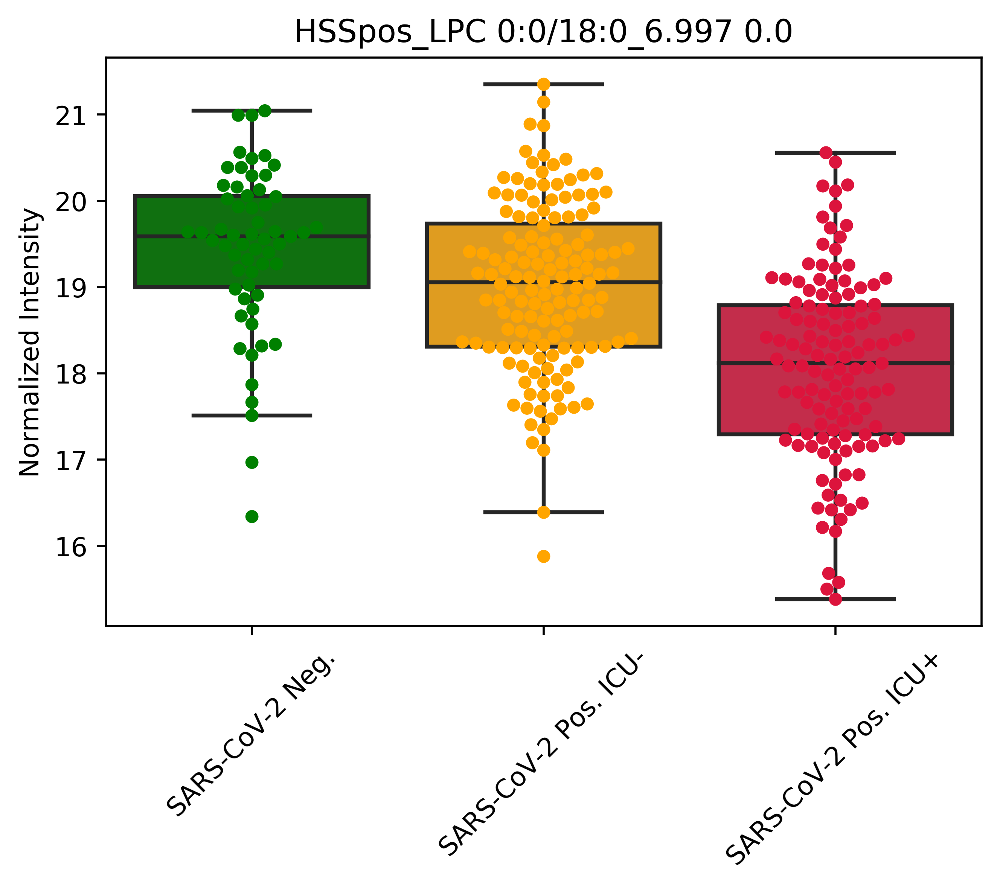

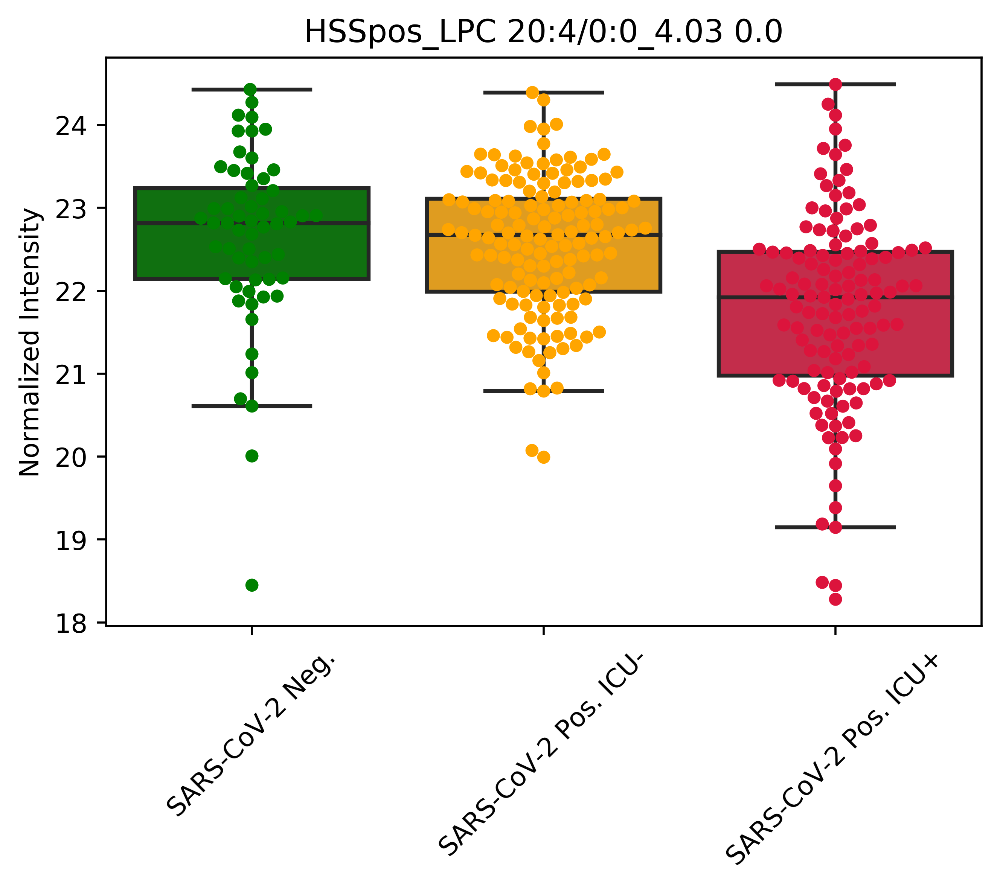

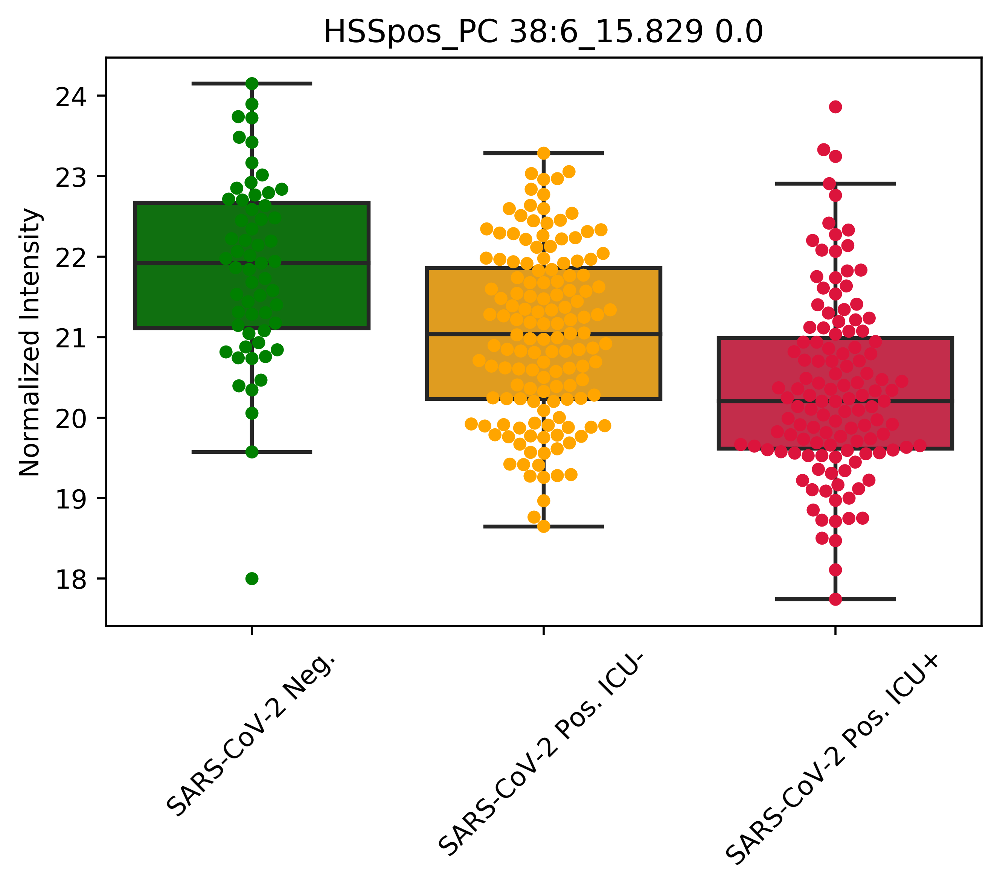

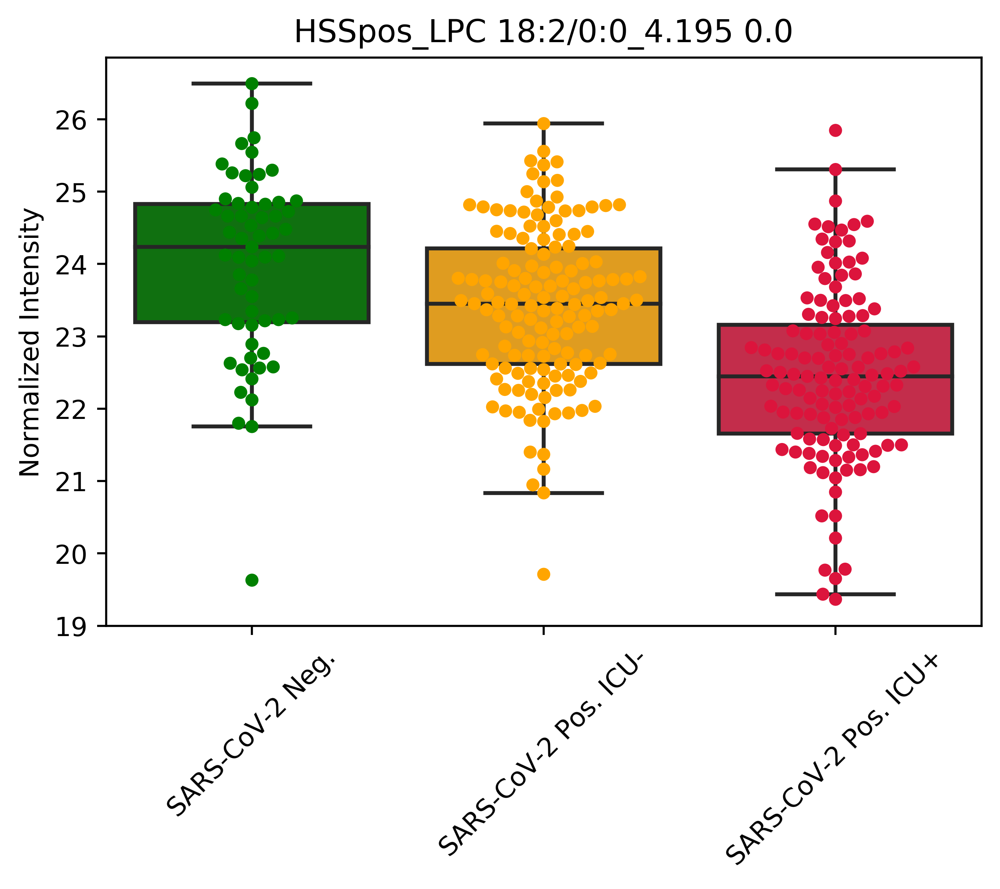

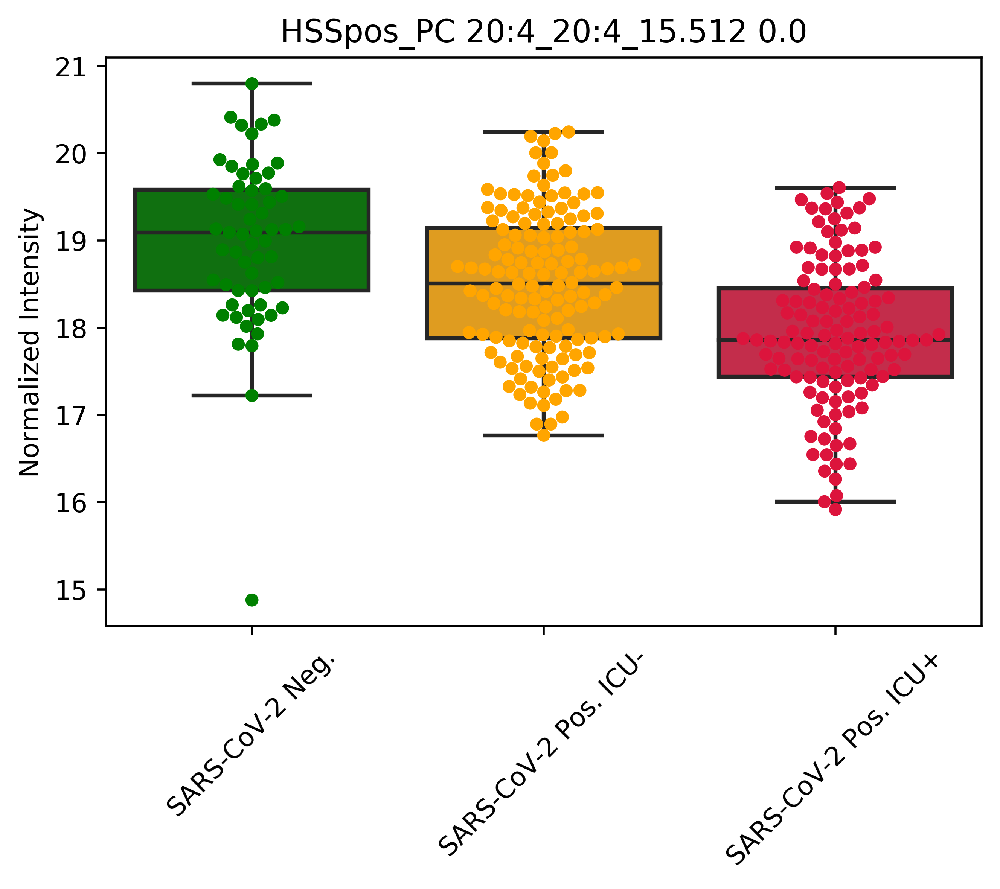

...

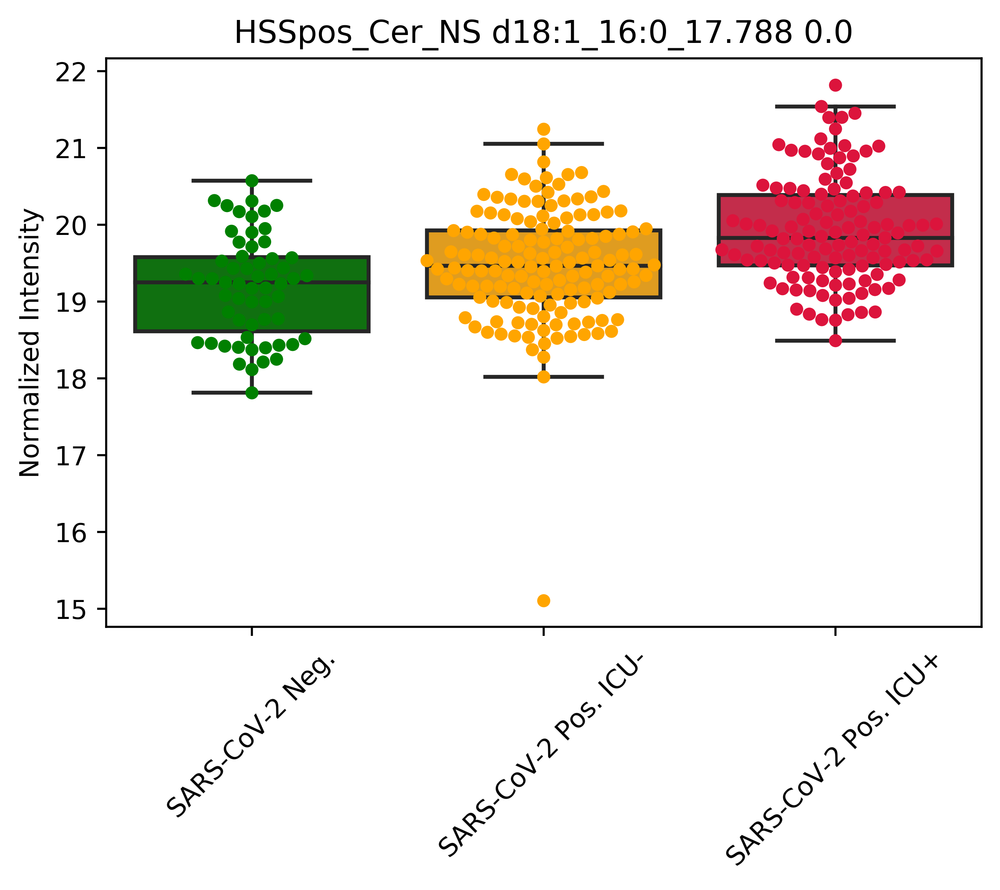

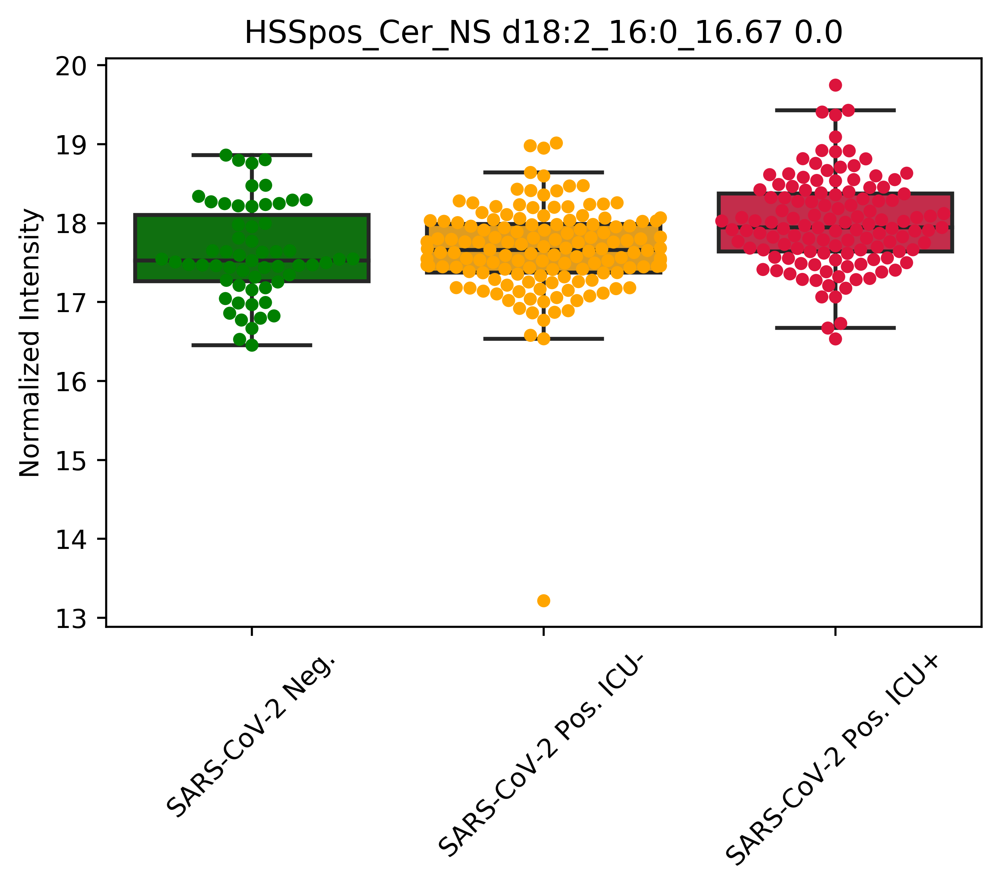

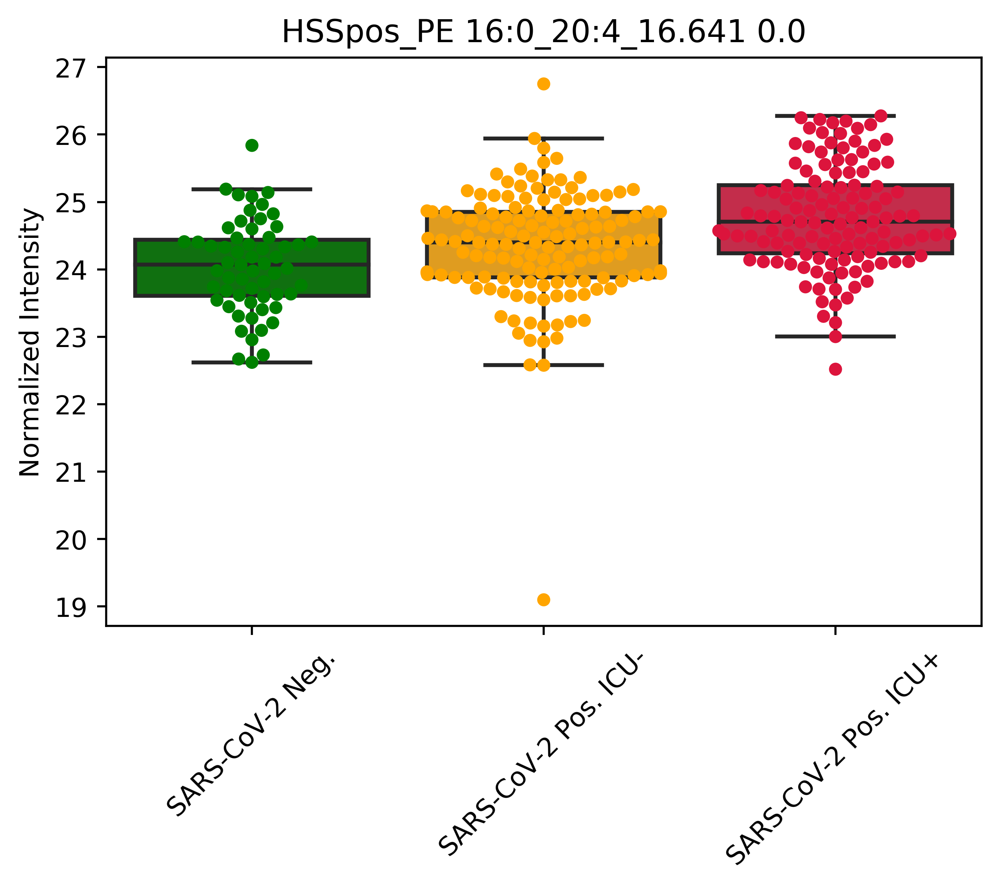

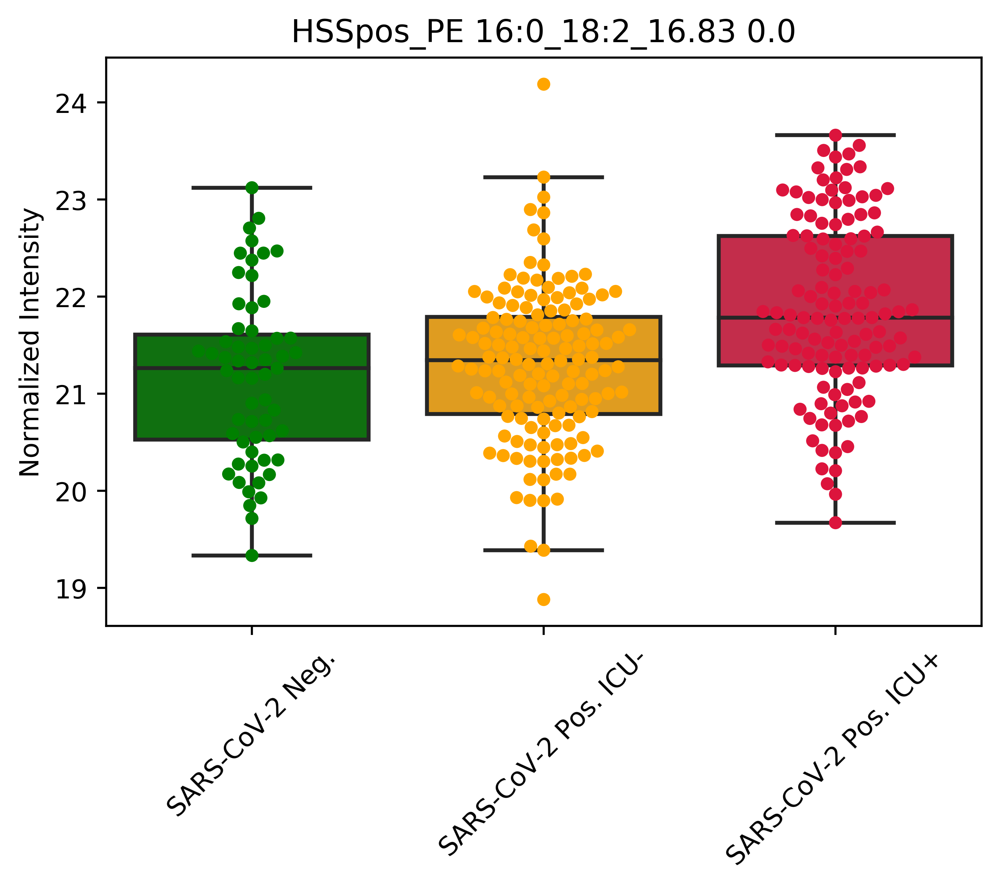

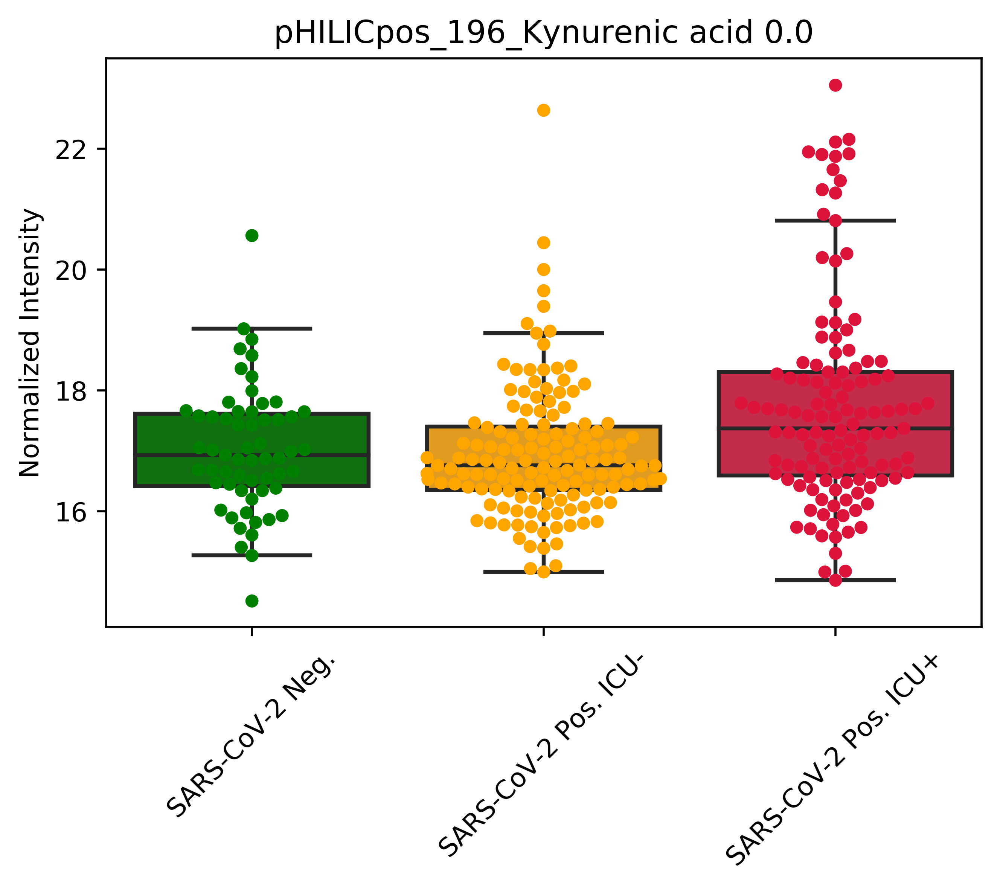

In [29]:
plots = []
pvals = []
names = []

for met,i in zip(goodMets,range(len(goodMets))):
    fig,ax = plt.subplots()
    norm = 1#np.median(X[:,met])
    tempX = np.concatenate((X_tot[:,i],X_val[:,order[met]]))
    tempy = np.concatenate((y_tot,[-1 for x in X_val]))
    tempDict = {}
    
    for x,yy,i in zip(tempX,tempy,range(len(tempX))):
        tempDict[i] = {"ICU":yy,"Normalized Intensity":x}
    tempDf = pd.DataFrame.from_dict(tempDict,orient="index")
    sb.swarmplot(data=tempDf,x="ICU",y="Normalized Intensity",palette={-1:"green",
                                                                                 0:"orange",
                                                                                 1:"crimson"})
    sb.boxplot(data=tempDf,x="ICU",y="Normalized Intensity",fliersize=0,palette={-1:"green",
                                                                                 0:"orange",
                                                                                 1:"crimson"})
    
    
    f,p = stats.f_oneway(*[tempDf[tempDf["ICU"] == x]["Normalized Intensity"] for x in [-1,0,1]])
    pvals.append(p)
    names.append(mol_names_sorted[met])
    
    plt.title(mol_names_sorted[met])
    
    plt.xticks([0,1,2],["SARS-CoV-2 Neg.","SARS-CoV-2 Pos. ICU-","SARS-CoV-2 Pos. ICU+"],rotation=45)
    plt.xlabel("")
    
    
    plots.append(ax)
    
alpha = 0.05
reject,pvals_corr,_,_ = multipletests(pvals,alpha,method="fdr_bh")

for p,plot,name in zip(pvals_corr,plots,names):
    print(name,p)
    plot.set_title(name + " " + str(np.round(p,3)))

    

In [30]:
plots = []
pvals = []
names = []
ind = 0

tempDict = {}

mapper = {-1:"SARS-CoV-2 Neg.",0:"SARS-CoV-2 Pos. ICU-",1:"SARS-CoV-2 Pos. ICU+"}
for met,i in zip(goodMets,range(len(goodMets))):
    norm = np.mean(X_val[:,order[met]])
    tempX = np.concatenate((X_tot[:,i],X_val[:,order[met]])) - norm
    tempy = np.concatenate((y_tot,[-1 for x in X_val]))
    
    for x,yy in zip(tempX,tempy):
        tempDict[ind] = {"ICU":mapper[yy],"Normalized Intensity":x,"Metabolite":mol_names_sorted[met]}
        ind += 1
    
    
tempDf = pd.DataFrame.from_dict(tempDict,orient="index")



    

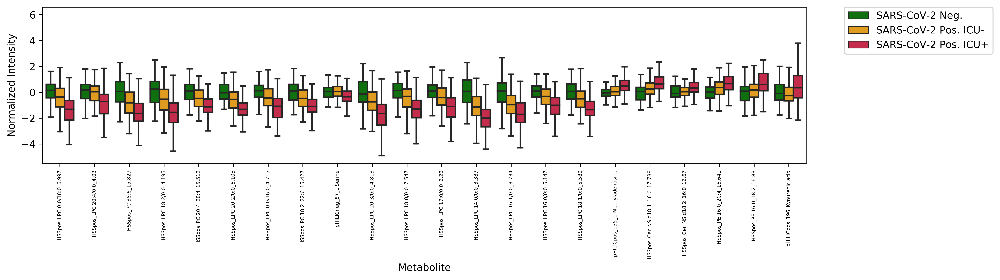

In [31]:
fig,ax = plt.subplots(figsize=(14,4))

# sb.swarmplot(data=tempDf,x="Metabolite",y="Normalized Intensity",hue="ICU",dodge=True,palette={mapper[-1]:"green",
#                                                                                  mapper[0]:"orange",
#                                                                                  mapper[1]:"crimson"},size=1.5)
sb.boxplot(data=tempDf,x="Metabolite",y="Normalized Intensity",hue="ICU",fliersize=0,palette={mapper[-1]:"green",
                                                                                 mapper[0]:"orange",
                                                                                 mapper[1]:"crimson"},
           hue_order=["SARS-CoV-2 Neg.","SARS-CoV-2 Pos. ICU-","SARS-CoV-2 Pos. ICU+"])
plt.xticks(rotation=90,fontsize=5)

handles, labels = ax.get_legend_handles_labels()
l = plt.legend(handles[0:3], labels[0:3], bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.tight_layout()
plt.savefig("../manuscript_figs/boxplots_individual_mets_all_pats.png")

HSSpos_LPC 0:0/18:0_6.997 2.1301877828341595e-08
HSSpos_LPC 20:4/0:0_4.03 8.530866866416648e-05
HSSpos_PC 38:6_15.829 6.957115870958851e-09
HSSpos_LPC 18:2/0:0_4.195 2.7161401921906606e-08
HSSpos_PC 20:4_20:4_15.512 2.7161401921906606e-08
HSSpos_LPC 20:2/0:0_6.105 3.054606908430331e-11
HSSpos_LPC 0:0/16:0_4.715 3.29084310311533e-08
HSSpos_PC 18:2_22:6_15.427 3.2919501399262846e-08
pHILICneg_87_L Serine 0.03736302343702082
HSSpos_LPC 20:3/0:0_4.813 2.0637735778133683e-08
HSSpos_LPC 18:0/0:0_7.547 3.5625728314243165e-08
HSSpos_LPC 17:0/0:0_6.28 2.7090711963538383e-07
HSSpos_LPC 14:0/0:0_3.387 3.8591160480462264e-12
HSSpos_LPC 16:1/0:0_3.734 6.126899485418359e-11
HSSpos_LPC 16:0/0:0_5.147 3.5625728314243165e-08
HSSpos_LPC 18:1/0:0_5.589 3.02619902096678e-09
pHILICpos_135_1 Methyladenosine 0.0008670854929724145
HSSpos_Cer_NS d18:1_16:0_17.788 0.00029415600756559356
HSSpos_Cer_NS d18:2_16:0_16.67 0.026842906304108283
HSSpos_PE 16:0_20:4_16.641 0.0028306345681620936
HSSpos_PE 16:0_18:2_16.83

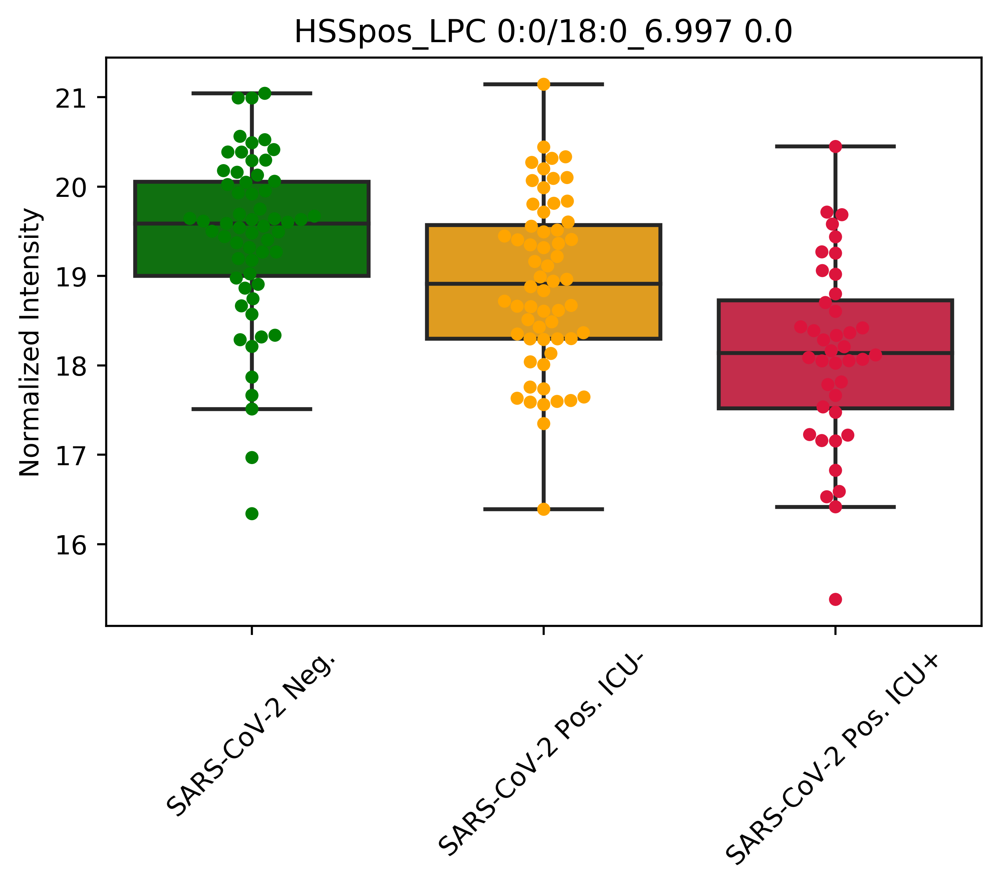

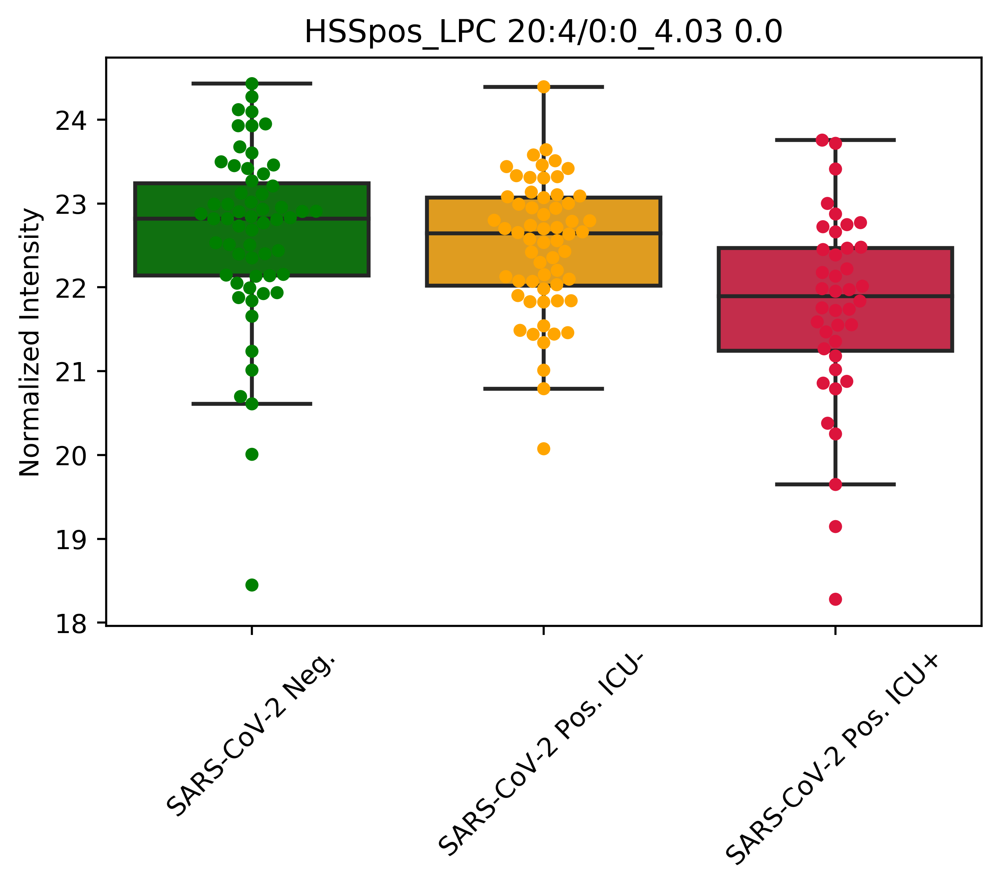

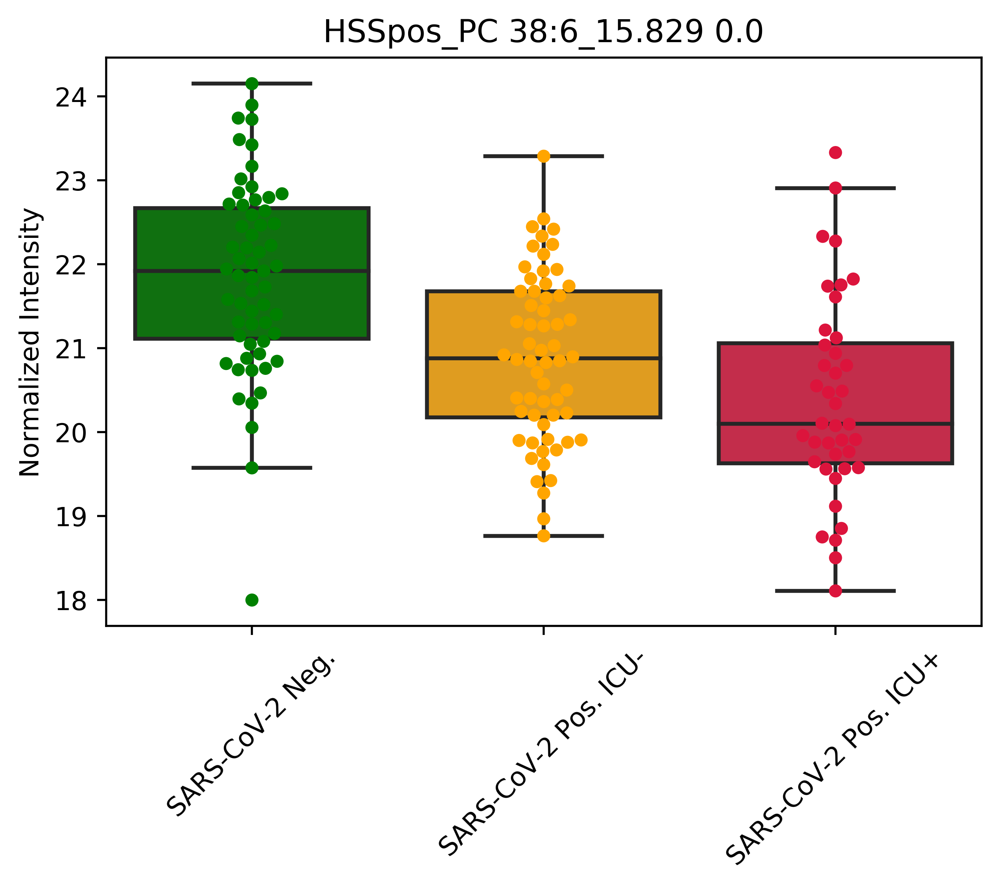

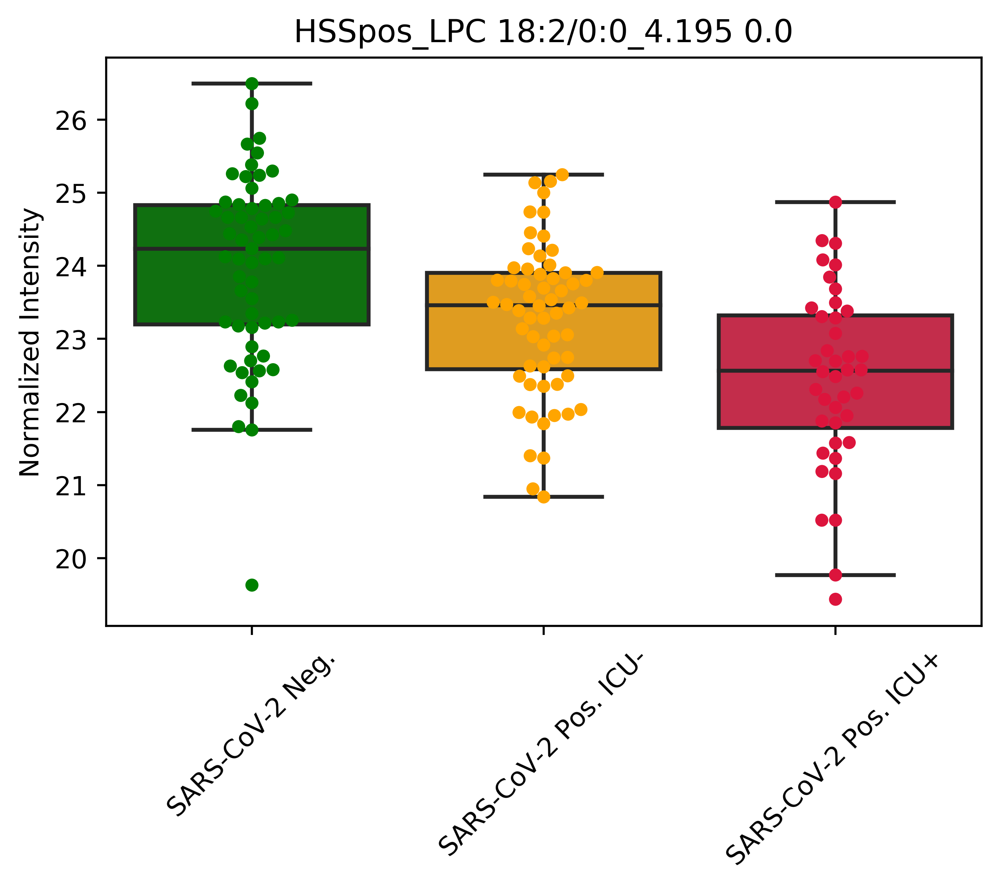

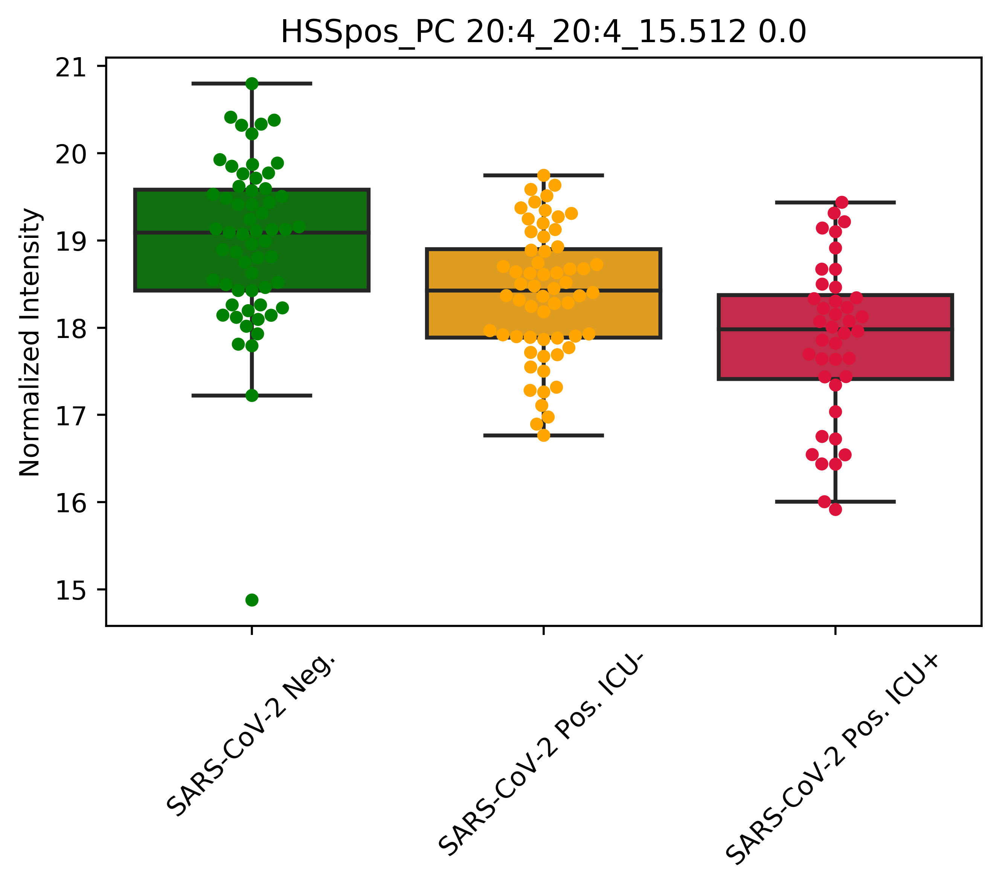

...

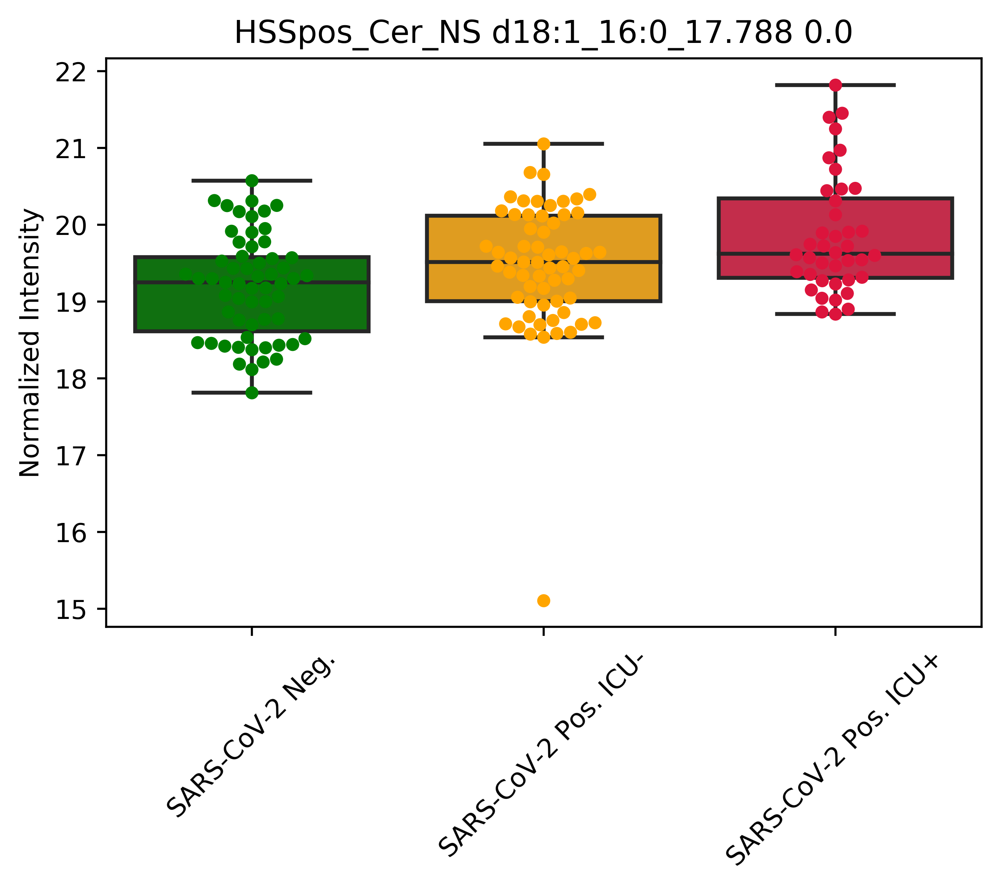

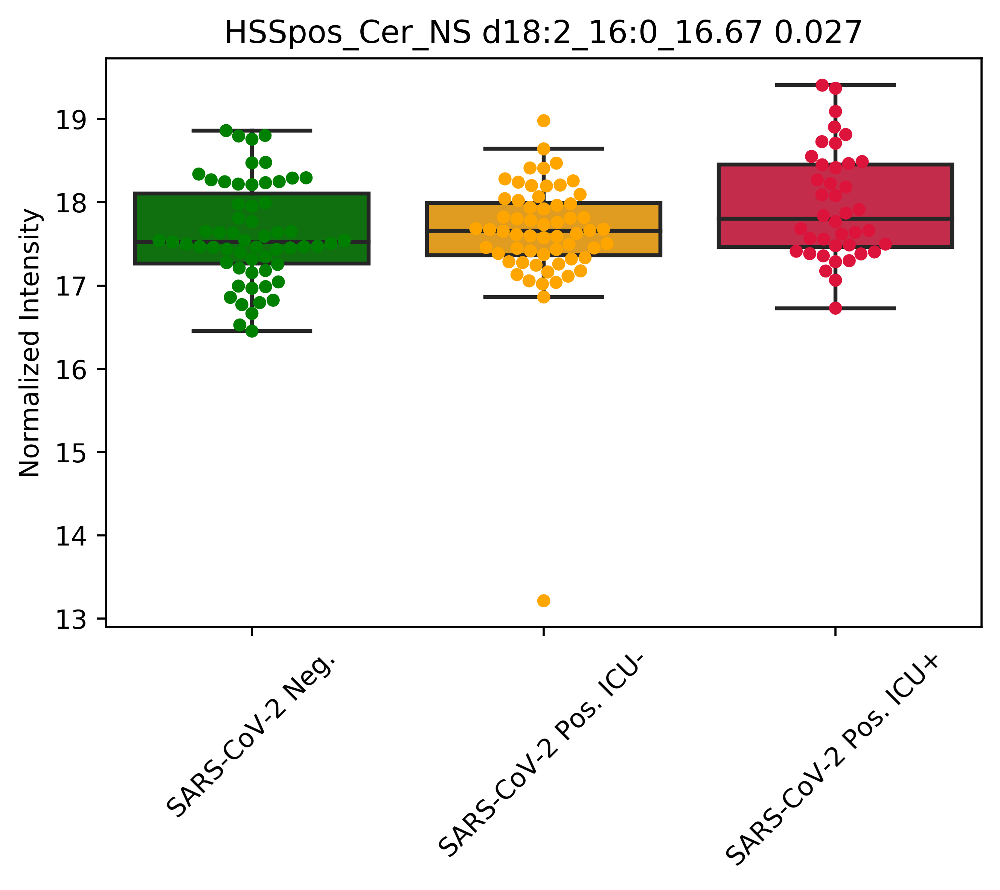

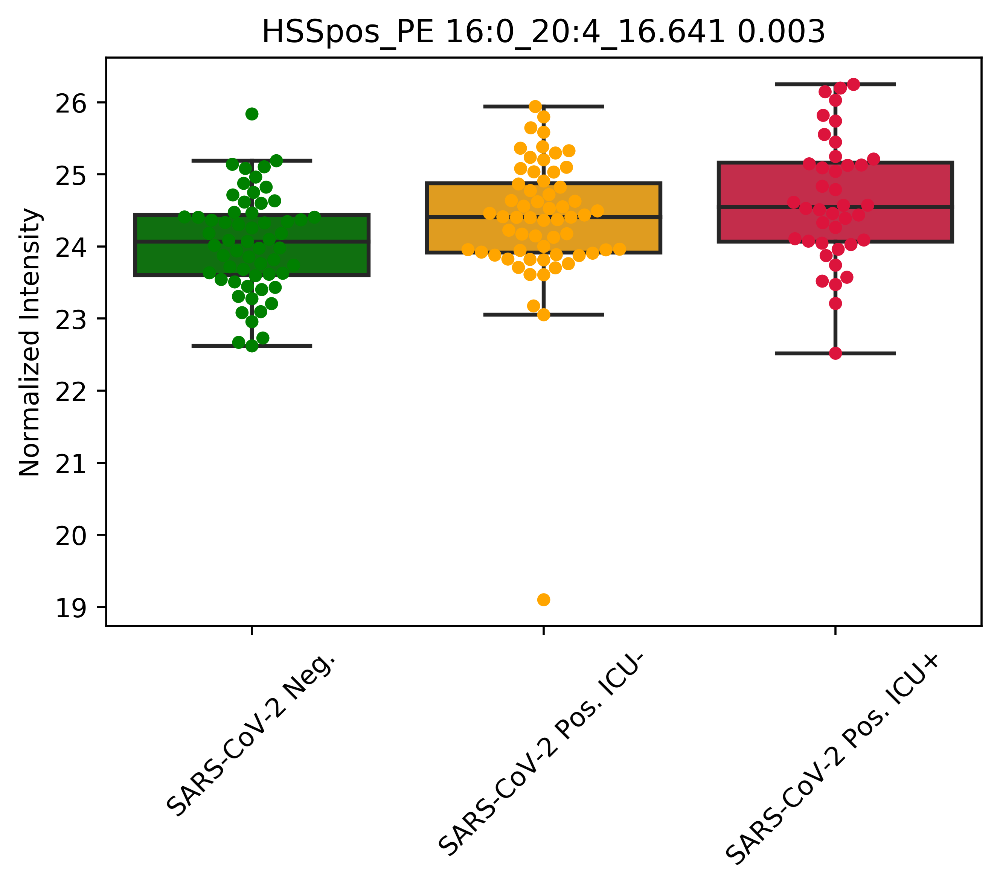

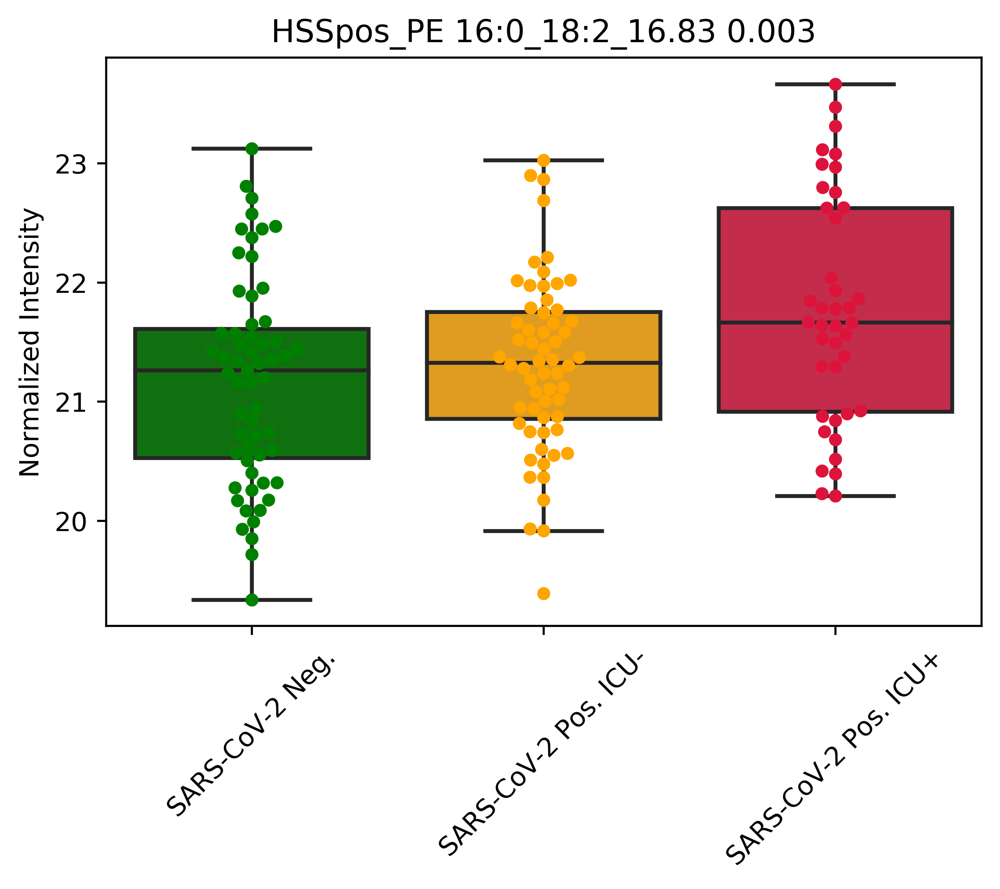

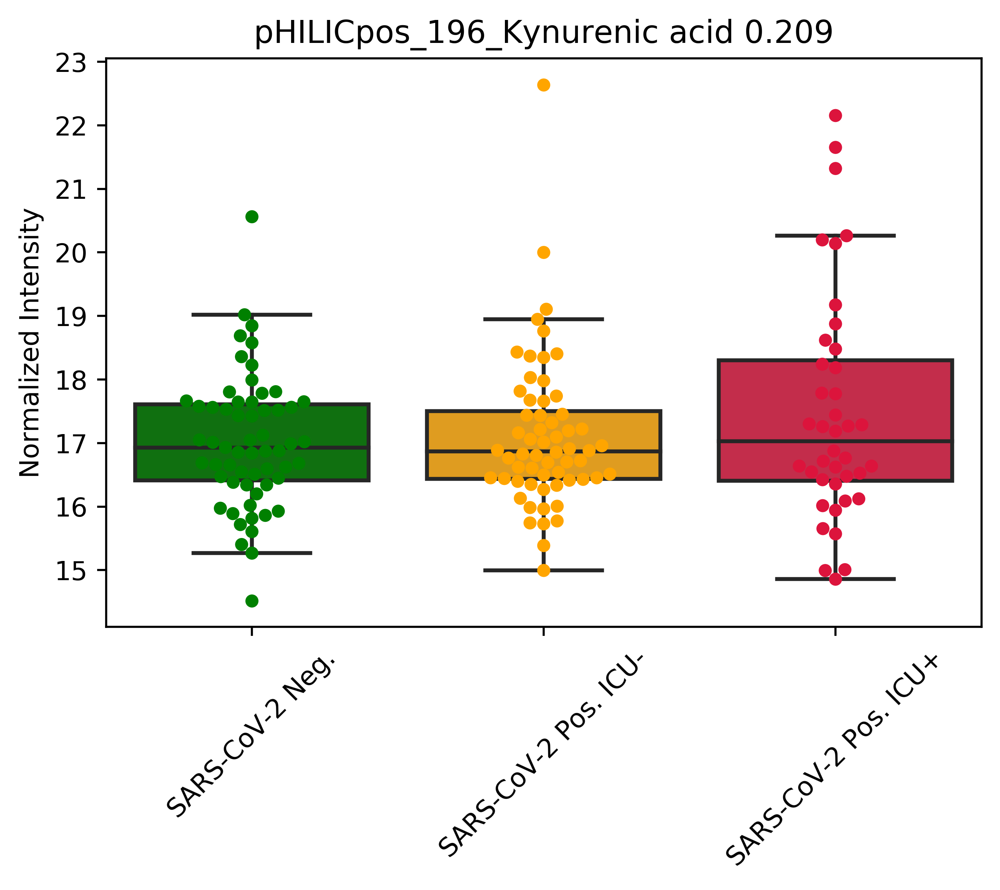

In [32]:
plots = []
pvals = []
names = []

for met,i in zip(goodMets,range(len(goodMets))):
    fig,ax = plt.subplots()
    norm = 1#np.median(X[:,met])
    tempX = np.concatenate((X_test[:,order[met]],X_val[:,order[met]]))
    tempy = np.concatenate((y_test,[-1 for x in X_val]))
    tempDict = {}
    
    for x,yy,i in zip(tempX,tempy,range(len(tempX))):
        tempDict[i] = {"ICU":yy,"Normalized Intensity":x}
    tempDf = pd.DataFrame.from_dict(tempDict,orient="index")
    sb.swarmplot(data=tempDf,x="ICU",y="Normalized Intensity",palette={-1:"green",
                                                                                 0:"orange",
                                                                                 1:"crimson"})
    sb.boxplot(data=tempDf,x="ICU",y="Normalized Intensity",fliersize=0,palette={-1:"green",
                                                                                 0:"orange",
                                                                                 1:"crimson"})
    
    
    f,p = stats.f_oneway(*[tempDf[tempDf["ICU"] == x]["Normalized Intensity"] for x in [-1,0,1]])
    pvals.append(p)
    names.append(mol_names_sorted[met])
    
    plt.title(mol_names_sorted[met])
    
    plt.xticks([0,1,2],["SARS-CoV-2 Neg.","SARS-CoV-2 Pos. ICU-","SARS-CoV-2 Pos. ICU+"],rotation=45)
    plt.xlabel("")
    
    
    plots.append(ax)
    
alpha = 0.05
reject,pvals_corr,_,_ = multipletests(pvals,alpha,method="fdr_bh")

for p,plot,name in zip(pvals_corr,plots,names):
    print(name,p)
    plot.set_title(name + " " + str(np.round(p,3)))

    

COV-:  59
COV+ non-severe:  60
COV+ severe:  40


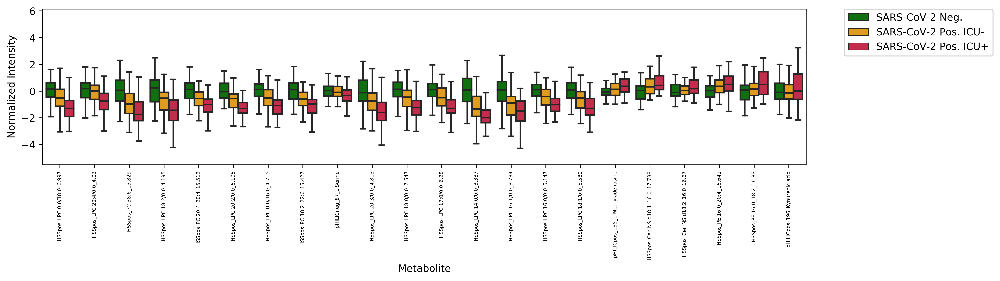

In [33]:
plots = []
pvals = []
names = []
ind = 0

tempDict = {}

mapper = {-1:"SARS-CoV-2 Neg.",0:"SARS-CoV-2 Pos. ICU-",1:"SARS-CoV-2 Pos. ICU+"}
for met,i in zip(goodMets,range(len(goodMets))):
    norm = np.mean(X_val[:,order[met]])
    tempX = np.concatenate((X_test[:,order[met]],X_val[:,order[met]])) - norm
    tempy = np.concatenate((y_test,[-1 for x in X_val]))
    
    for x,yy in zip(tempX,tempy):
        tempDict[ind] = {"ICU":mapper[yy],"Normalized Intensity":x,"Metabolite":mol_names_sorted[met]}
        ind += 1
    
    
tempDf = pd.DataFrame.from_dict(tempDict,orient="index")

print("COV-: ",len([x for x in tempy if x < -.5]))
print("COV+ non-severe: ",len([x for x in tempy if x > -.5 and x < .5]))
print("COV+ severe: ",len([x for x in tempy if x > .5]))

    

fig,ax = plt.subplots(figsize=(14,4))

# sb.swarmplot(data=tempDf,x="Metabolite",y="Normalized Intensity",hue="ICU",dodge=True,palette={mapper[-1]:"green",
#                                                                                  mapper[0]:"orange",
#                                                                                  mapper[1]:"crimson"},size=1.5)
sb.boxplot(data=tempDf,x="Metabolite",y="Normalized Intensity",hue="ICU",fliersize=0,palette={mapper[-1]:"green",
                                                                                 mapper[0]:"orange",
                                                                                 mapper[1]:"crimson"},
           hue_order=["SARS-CoV-2 Neg.","SARS-CoV-2 Pos. ICU-","SARS-CoV-2 Pos. ICU+"])
plt.xticks(rotation=90,fontsize=5)

handles, labels = ax.get_legend_handles_labels()
l = plt.legend(handles[0:3], labels[0:3], bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

plt.tight_layout()
plt.savefig("../manuscript_figs/test_set_patients_boxplot_individual_mets.png")